# Honor Statement

## “I am aware of and understand the collaboration and use of outside resource policy for this assignment, and affirm I have followed this policy in the completion of this assignment. I am aware of the course and campus policies on Academic Integrity and am aware of the consequences if this policy is not adhered to.”

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"></ul></div>

In [2559]:
# Allows us to use various mathermatical functions
import numpy as np
#Allows us to plot functions and simulations
import matplotlib.pyplot as plt
#Allows us to define units precisely
from astropy import units as u
#Allows us to define constants precisely
from astropy import constants as const
import scipy
from scipy import fft

# Coulomb Force

### Create Coulomb Force Loop

#### Define coulomb force, and create a definition for the force that will return the equations you want with specific parameters. In order to do this problem properly we have to use the difference in position of the electron and the ion at the origin. We also include a position vector that will track the normal of the change in radius.

In [3144]:
# We know the Coulomb Force is ((k * (q) * (+Z * q)) / r^2)
# We need to find the magnitude of the force vector and then multiply 
# by the position vector


def coulomb_x(rx_i, ry_i, q):
    # Write out the colomb force energy equation
    #Coulomb Force = ((k * (q) * (+Z * q)) / r^2)
    mag_r = np.sqrt(rx_i**2+ry_i**2)
    #r_hat = position vector / magnitude of the position vector
    Fc_vecx = (((-q) * (+Z*q)) / ((mag_r)**2))
    #print('This is Fc',Fc_vec)
    #print('This is mag_r',mag_r)
    return Fc_vecx * (rx_i/mag_r)


def coulomb_y(rx_i, ry_i, q):
    # Write out the colomb force energy equation
    #Coulomb Force = ((k * (q) * (+Z * q)) / r^2)
    mag_r = np.sqrt(rx_i**2+ry_i**2)
    #r_hat = position vector / magnitude of the position vector
    Fc_vecy = (((-q) * (+Z*q)) / ((mag_r)**2))
    #print('This is Fc',Fc_vec)
    #print('This is mag_r',mag_r)
    return Fc_vecy * (ry_i/mag_r)



In [1771]:
# -- Test the magnitudes for the fucntion -- 

rxt = -500*const.a0
ryt =  200*const.a0

rt = [rxt.value, ryt.value]


mag_rt = np.sqrt(rxt**2+ryt**2) #Magnitude of the Position
mag_rtt = np.linalg.norm(rt)

print(mag_rt)
print(mag_rtt)

2.8497064928924285e-08 m
2.8497064928924285e-08


## Define Iterations

In [3143]:
## Take a guess at 1000
N = 1000

# Initial Conditions Plot (x=-400, b=200, vx0= 10^4)

## Create empty arrays that will store all the variables that you need like position(r), velocity(v), and accleration(a)

In [2621]:
# The reason we are making these arrays is because we need to run these through a loop, 
# and in a loop we have to define the variables that we are looping through beforehand

#Have to make 2-d arrays with (2,2) to store both x and y positions with an intial 
# guess for the amount of times we are gonna iterate through the loop we will make
rx = np.zeros([N])
vx = np.zeros([N])
ax = np.zeros([N])

ry = np.zeros([N])
vy = np.zeros([N])
ay = np.zeros([N])

#Time Array
T = np.zeros([N])

## Define the constants k, initial postition (r0), initial velocity (v0), and the mass of the electron (me) with what is given in the problem 

In [3049]:
k = 1 #/ (4 * np.pi * const.eps0) # Coulomb Constant
Z = 50 # Z is the charged ion since there is no specifications we can just use Z = 1
#q and me from: Brooks, A , Physical constants, https://www.physics.rutgers.edu/~abrooks/342/constants.html
# , Accessed Nov 2, 2022)
#q = const.e.esu.value
q = 4.8032*10**(-10)
me =  9.1094*10**(-28)
a0 = 5.2917721067 * 10**(-9)

#X-Component of the electron
rx0 = -400#Initial Radius away from ion
rx[0] = rx0 #This will be the first indice 
vx0 = 10**(4)#* u.cm/u.s # 10^7 cm/s but change to m/s because all the other constants are in m
vx[0] = vx0

# #Y-Component of the electron
ry0 = 200 #Initial Radius away from ion
ry[0] = ry0 # This will be the first indice 
vy0 = 0 # 10^7 cm/s but change to m/s because all the other constants are in m
vy[0] = vy0


#Intial Time
T[0] = 0


## Estimate Timestep

In [3050]:
## We will make a estimate of the timestep that we will use for the simulation
dt = 10**(-4)

## Create a Loop For The  Simulation

In [3097]:
## In this loop we have to run through the time steps and 


## To be transparent this structure is close to Roman Gerasimov's stucture of the kinematic equations to get the 
## position, velocity, and acceleration components. In the case that I do have to cite this is the citation:
## Gerasimov, Roman, production.ipynb, https://colab.research.google.com/drive/1v5rQPIA24jJ82AmUrsd3sqg3WyF1WdZD?usp=sharing
## , Accesssed 4 Nov 2022)

for i in range(N):
    #X-components and y-components of the acceleration
    ax[i] = coulomb_x(rx[i], ry[i], q)/ me
    ay[i] = coulomb_y(rx[i], ry[i], q)/ me
    
#     ax[i]
#     ay[i]
    #print(axy)
    if i == N-1:
        break
    #X-components and y-components of the velocity updated by the iterations of accleration
    vx[i+1] = vx[i] + ax[i] * dt
    vy[i+1] = vy[i] + ay[i] * dt

    #X-components and y-components of the position updated by the iterations of accleration and velocity
    rx[i+1] = rx[i] + vx[i] * dt + ((1.0 / 2.0) * ax[i] * dt ** 2.0)
    ry[i+1] = ry[i] + vy[i] * dt + ((1.0 / 2.0) * ay[i] * dt ** 2.0)
    #The time vector that takes into account the changing of time and updates as the loop iterates    
    T[i+1] = T[i] + dt
    

In [3106]:
## -- Test values by printing them --

In [3105]:
#T

In [3053]:
# print(ax)

In [3054]:
# print(ay)

In [3055]:
# print(ry)

In [3056]:
# print(rx)

In [3057]:
# print(vx)

## Position vs Position Plot

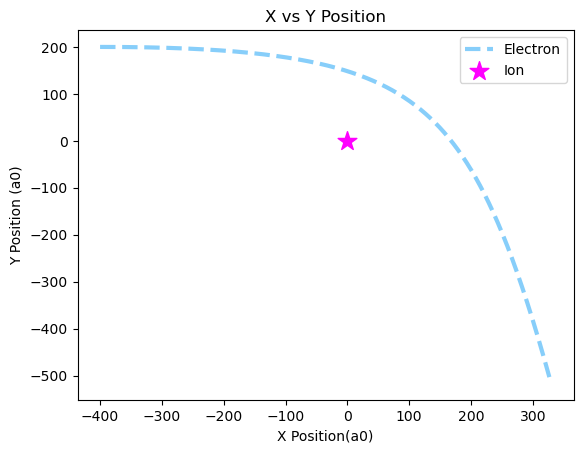

In [3077]:
plt.plot(rx, ry, ls="--",linewidth=3, c= 'lightskyblue', label='Electron')
# limup = 2000000000000*const.a0.value
# plt.ylim(-1000000000000*const.a0.value,limup)
# plt.xlim(-6000000000000*const.a0.value,limup)
plt.xlabel('X Position(a0)')
plt.ylabel('Y Position (a0)')
plt.title('X vs Y Position')
plt.scatter(0, 0, c='magenta', marker='*', s = 200, label = 'Ion')
plt.legend()

plt.show()

## 

## Time vs Velocity

In [3098]:
# -- Time Check to make sure I can get a resonable value--

10**(-4)*N

0.1

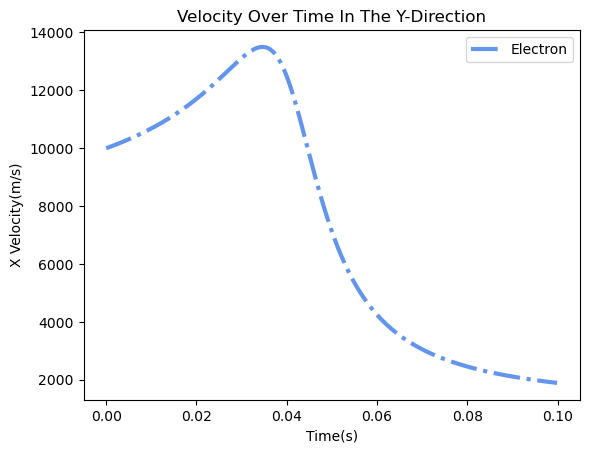

In [3145]:
plt.plot(T, vx, ls="-.",linewidth=3, c= 'cornflowerblue',label = 'Electron')
plt.title('Velocity Over Time In The Y-Direction')
plt.ylabel('X Velocity(m/s)')
plt.xlabel('Time(s)')
plt.legend()

plt.show()

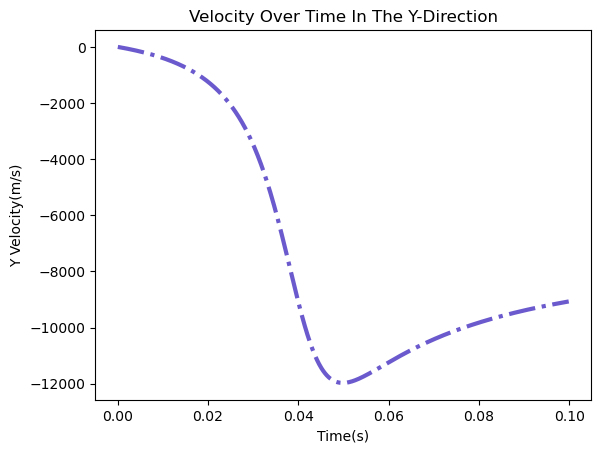

In [3146]:
plt.plot(T, vy, ls="-.",linewidth=3, c= 'slateblue',label = 'Electron')
plt.title('Velocity Over Time In The Y-Direction')
plt.ylabel('Y Velocity(m/s)')
plt.xlabel('Time(s)')
plt.legend

plt.show()

## Time vs Accleration

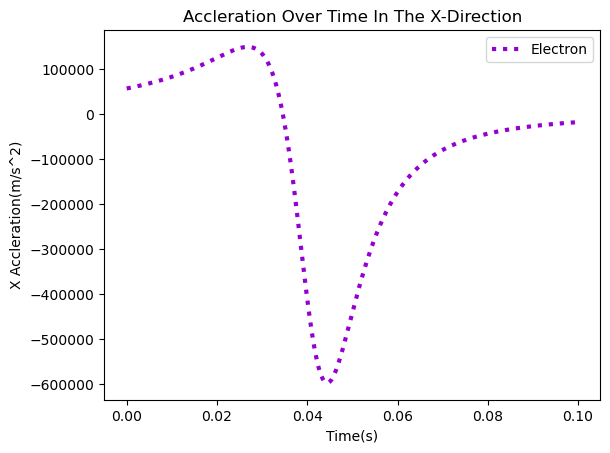

In [3148]:
plt.plot(T, ax, ls=":",linewidth=3, c= 'darkviolet',label = 'Electron')
plt.title('Accleration Over Time In The X-Direction')
plt.ylabel('X Accleration(m/s^2)')
plt.xlabel('Time(s)')
plt.legend()

plt.show()

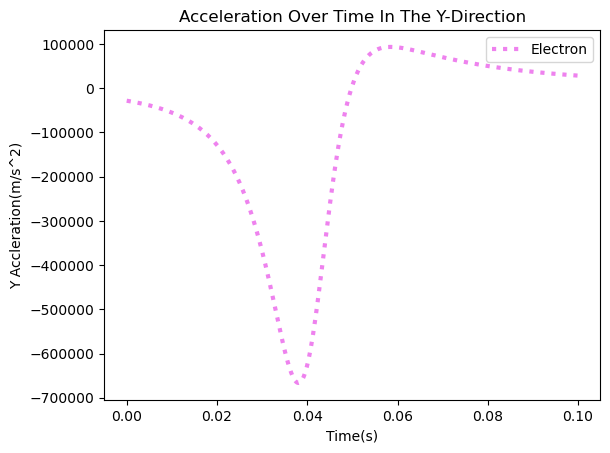

In [3152]:
plt.plot(T, ay, ls=":",linewidth=3, c= 'violet',label = 'Electron')
plt.title('Acceleration Over Time In The Y-Direction')
plt.xlabel('Time(s)')
plt.ylabel('Y Accleration(m/s^2)')
plt.legend()


plt.show()

## Power Spectrum of the Electron

In [3107]:
#Use 3.26 and 5.2

# -- Checking to make sure the omega values I get are okay --
omega = np.linspace(0,1000,N)
print(omega)

[   0.            1.001001      2.002002      3.003003      4.004004
    5.00500501    6.00600601    7.00700701    8.00800801    9.00900901
   10.01001001   11.01101101   12.01201201   13.01301301   14.01401401
   15.01501502   16.01601602   17.01701702   18.01801802   19.01901902
   20.02002002   21.02102102   22.02202202   23.02302302   24.02402402
   25.02502503   26.02602603   27.02702703   28.02802803   29.02902903
   30.03003003   31.03103103   32.03203203   33.03303303   34.03403403
   35.03503504   36.03603604   37.03703704   38.03803804   39.03903904
   40.04004004   41.04104104   42.04204204   43.04304304   44.04404404
   45.04504505   46.04604605   47.04704705   48.04804805   49.04904905
   50.05005005   51.05105105   52.05205205   53.05305305   54.05405405
   55.05505506   56.05605606   57.05705706   58.05805806   59.05905906
   60.06006006   61.06106106   62.06206206   63.06306306   64.06406406
   65.06506507   66.06606607   67.06706707   68.06806807   69.06906907
   70.07

In [3101]:
# list(T)q

In [3102]:
## Create empty arrays for the different vectors I need
d = np.zeros(1000)
Freq = np.zeros(1000)
mag_v = np.zeros(1000)


#Define c so that we dont run into unit errors
c = 3*10**8

# omega[i] = np.linspace(0,1000,N)
# N = 1000

# for i in range(1000):
#     mag_v = np.sqrt(vx[i]**2+vy[i]**2) #Take the magnitude of velocity so that you can calculate omega

mag_a = np.sqrt(ax**2+ay**2) #Create a magnitude foe accleration to use in the loop below

for i in np.linspace(0,1000,N):
    # omega = magnitude of velocity / the y component of position (b)
#     mag_v = np.sqrt(vx[i]**2+vy[i]**2) #Take the magnitude of velocity so that you can calculate omega
#     omega = mag_v / ry0 #Divide the magnitude of velocity by the y position
#     print('This is Omega',omega)
    omega = i
    for k in range(len((list(T)))):
        d[k] = ((q /2*np.pi) * (np.sum(mag_a*e_exp**(j*omega*T[k])*dt)))
        print('This is d=',d[k])
#         print('This is d1',d[1])
#         print('This is d2',d[2])
#         print('This is d-2',d[-2])
#         print('This is d-1',d[-1])
        Freq[k] = ((8 *np.pi* omega**4)/ (3 * (c)**3)) * (np.abs(d[k]))**2
        print('This is Freq=',Freq[k])
#         print('This is Freq1',Freq[1])
#         print('This is Freq1',Freq[2])
#         print('This is Freq-2',Freq[-2])
#         print('This is Freq-1',Freq[-1])

This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1.7526556028333898e-05
This is Freq= 0.0
This is d= 1

This is d= 2.13941306868863e-05
This is Freq= 1.8479370726007436e-31
This is d= 2.1406983874055765e-05
This is Freq= 1.8501581505457797e-31
This is d= 2.1419844783175846e-05
This is Freq= 1.852381898055334e-31
This is d= 2.1432713418885725e-05
This is Freq= 1.8546083183380143e-31
This is d= 2.144558978582741e-05
This is Freq= 1.856837414606291e-31
This is d= 2.1458473888645657e-05
This is Freq= 1.859069190076489e-31
This is d= 2.1471365731988048e-05
This is Freq= 1.8613036479688054e-31
This is d= 2.148426532050494e-05
This is Freq= 1.8635407915073037e-31
This is d= 2.1497172658849482e-05
This is Freq= 1.8657806239199238e-31
This is d= 2.1510087751677624e-05
This is Freq= 1.8680231484384844e-31
This is d= 2.1523010603648117e-05
This is Freq= 1.8702683682986908e-31
This is d= 2.153594121942251e-05
This is Freq= 1.8725162867401357e-31
This is d= 2.1548879603665137e-05
This is Freq= 1.8747669070063049e-31
This is d= 2.1561825761043154e-05
This is Freq= 1.877020232344584e-31
This is d= 2.15

This is d= 1.8297423564040637e-05
This is Freq= 1.0429722924006327e-30
This is d= 1.831574847344017e-05
This is Freq= 1.0450624165362997e-30
This is d= 1.8334091735276237e-05
This is Freq= 1.0471567292960896e-30
This is d= 1.8352453367928824e-05
This is Freq= 1.0492552390740343e-30
This is d= 1.8370833389796354e-05
This is Freq= 1.0513579542809898e-30
This is d= 1.838923181929566e-05
This is Freq= 1.0534648833446662e-30
This is d= 1.840764867486203e-05
This is Freq= 1.0555760347096639e-30
This is d= 1.842608397494921e-05
This is Freq= 1.0576914168375058e-30
This is d= 1.844453773802943e-05
This is Freq= 1.0598110382066718e-30
This is d= 1.846300998259341e-05
This is Freq= 1.0619349073126319e-30
This is d= 1.84815007271504e-05
This is Freq= 1.0640630326678827e-30
This is d= 1.850000999022818e-05
This is Freq= 1.0661954228019778e-30
This is d= 1.8518537790373098e-05
This is Freq= 1.0683320862615668e-30
This is d= 1.8537084146150062e-05
This is Freq= 1.0704730316104253e-30
This is d= 1.85

This is d= 3.699061252784518e-05
This is Freq= 1.6375255175992692e-29
This is d= 3.704248756446502e-05
This is Freq= 1.6421216166805528e-29
This is d= 3.709443534979704e-05
This is Freq= 1.6467306157908965e-29
This is d= 3.714645598586286e-05
This is Freq= 1.6513525511372557e-29
This is d= 3.7198549574827174e-05
This is Freq= 1.6559874590282083e-29
This is d= 3.7250716218997945e-05
This is Freq= 1.6606353758742398e-29
This is d= 3.730295602082661e-05
This is Freq= 1.6652963381880305e-29
This is d= 3.735526908290829e-05
This is Freq= 1.6699703825847442e-29
This is d= 3.7407655507981963e-05
This is Freq= 1.6746575457823102e-29
This is d= 3.746011539893073e-05
This is Freq= 1.6793578646017193e-29
This is d= 3.751264885878193e-05
This is Freq= 1.6840713759673056e-29
This is d= 3.756525599070741e-05
This is Freq= 1.6887981169070417e-29
This is d= 3.7617936898023676e-05
This is Freq= 1.693538124552827e-29
This is d= 3.767069168419216e-05
This is Freq= 1.698291436140781e-29
This is d= 3.77235

This is d= 4.080327154359298e-05
This is Freq= 5.444686511012414e-29
This is d= 4.0876857225278635e-05
This is Freq= 5.464342397685142e-29
This is d= 4.0950575613297484e-05
This is Freq= 5.484069244160624e-29
This is d= 4.1024426946975595e-05
This is Freq= 5.503867306611159e-29
This is d= 4.1098411466070605e-05
This is Freq= 5.523736842133845e-29
This is d= 4.1172529410772604e-05
This is Freq= 5.543678108753947e-29
This is d= 4.1246781021704766e-05
This is Freq= 5.5636913654282e-29
This is d= 4.132116653992426e-05
This is Freq= 5.583776872048222e-29
This is d= 4.1395686206922975e-05
This is Freq= 5.603934889443858e-29
This is d= 4.147034026462832e-05
This is Freq= 5.624165679386578e-29
This is d= 4.1545128955403955e-05
This is Freq= 5.644469504592869e-29
This is d= 4.16200525220507e-05
This is Freq= 5.664846628727662e-29
This is d= 4.1695111207807204e-05
This is Freq= 5.685297316407741e-29
This is d= 4.177030525635078e-05
This is Freq= 5.70582183320518e-29
This is d= 4.18456349117982e-

This is d= 7.382926930879955e-05
This is Freq= 3.977779924833775e-28
This is d= 7.399203544444906e-05
This is Freq= 3.99533831499568e-28
This is d= 7.415516041901384e-05
This is Freq= 4.012974209964513e-28
This is d= 7.43186450236005e-05
This is Freq= 4.030687951855639e-28
This is d= 7.448249005105979e-05
This is Freq= 4.048479884294567e-28
This is d= 7.464669629599035e-05
This is Freq= 4.066350352423606e-28
This is d= 7.481126455474259e-05
This is Freq= 4.0842997029085555e-28
This is d= 7.49761956254227e-05
This is Freq= 4.102328283945459e-28
This is d= 7.514149030789624e-05
This is Freq= 4.120436445267315e-28
This is d= 7.530714940379226e-05
This is Freq= 4.138624538150896e-28
This is d= 7.547317371650718e-05
This is Freq= 4.156892915423561e-28
This is d= 7.563956405120841e-05
This is Freq= 4.17524193147007e-28
This is d= 7.580632121483866e-05
This is Freq= 4.193671942239497e-28
This is d= 7.597344601611953e-05
This is Freq= 4.212183305252108e-28
This is d= 7.614093926555558e-05
This

This is d= 0.00016132757701649614
This is Freq= 3.1671610292122483e-27
This is d= 0.00016173180526184326
This is Freq= 3.1830524210896924e-27
This is d= 0.00016213704635618576
This is Freq= 3.1990235488357745e-27
This is d= 0.0001625433028373552
This is Freq= 3.21507481252929e-27
This is d= 0.00016295057724954157
This is Freq= 3.231206614256432e-27
This is d= 0.00016335887214331002
This is Freq= 3.247419358120896e-27
This is d= 0.00016376819007561617
This is Freq= 3.2637134502539745e-27
This is d= 0.00016417853360982274
This is Freq= 3.2800892988247574e-27
This is d= 0.00016458990531571498
This is Freq= 3.2965473140503304e-27
This is d= 0.0001650023077695174
This is Freq= 3.3130879082060766e-27
This is d= 0.00016541574355390942
This is Freq= 3.329711495635985e-27
This is d= 0.00016583021525804178
This is Freq= 3.346418492763041e-27
This is d= 0.0001662457254775526
This is Freq= 3.3632093180996466e-27
This is d= 0.00016666227681458388
This is Freq= 3.3800843922581196e-27
This is d= 0.00

This is d= 4.026767548178015e-05
This is Freq= 4.091579808147671e-28
This is d= 4.0388781181554746e-05
This is Freq= 4.116227804965866e-28
This is d= 4.051025110872371e-05
This is Freq= 4.141024283244924e-28
This is d= 4.063208635870694e-05
This is Freq= 4.165970137448778e-28
This is d= 4.075428803021886e-05
This is Freq= 4.1910662674296855e-28
This is d= 4.087685722527826e-05
This is Freq= 4.216313578460683e-28
This is d= 4.09997950492183e-05
This is Freq= 4.24171298126824e-28
This is d= 4.112310261069642e-05
This is Freq= 4.267265392065117e-28
This is d= 4.124678102170438e-05
This is Freq= 4.292971732583409e-28
This is d= 4.137083139757827e-05
This is Freq= 4.318832930107798e-28
This is d= 4.149525485700859e-05
This is Freq= 4.344849917509006e-28
This is d= 4.162005252205029e-05
This is Freq= 4.371023633277433e-28
This is d= 4.174522551813295e-05
This is Freq= 4.397355021557027e-28
This is d= 4.1870774974070855e-05
This is Freq= 4.423845032179324e-28
This is d= 4.199670202207326e-05


This is d= 4.267473709088024e-05
This is Freq= 8.51347320961102e-28
This is d= 4.282451039423595e-05
This is Freq= 8.573336662931315e-28
This is d= 4.2974809349158086e-05
This is Freq= 8.633621052919319e-28
This is d= 4.312563580049855e-05
This is Freq= 8.69432933943898e-28
This is d= 4.3276991599584104e-05
This is Freq= 8.755464503166895e-28
This is d= 4.342887860423896e-05
This is Freq= 8.81702954573861e-28
This is d= 4.358129867880764e-05
This is Freq= 8.87902748989601e-28
This is d= 4.37342536941779e-05
This is Freq= 8.941461379635747e-28
This is d= 4.38877455278036e-05
This is Freq= 9.00433428035866e-28
This is d= 4.404177606372783e-05
This is Freq= 9.06764927902032e-28
This is d= 4.419634719260601e-05
This is Freq= 9.131409484282568e-28
This is d= 4.4351460811729096e-05
This is Freq= 9.195618026666158e-28
This is d= 4.4507118825046854e-05
This is Freq= 9.260278058704453e-28
This is d= 4.466332314319125e-05
This is Freq= 9.325392755098209e-28
This is d= 4.48200756834999e-05
This i

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 0.0004489719713958646
This is Freq= 2.7031579469305173e-24
This is d= 0.00045262708267181144
This is Freq= 2.7473502885296202e-24
This is d= 0.0004563119504566067
This is Freq= 2.7922651047655553e-24
This is d= 0.0004600268170000076
This is Freq= 2.8379142069518242e-24
This is d= 0.00046377192652394283
This is Freq= 2.8843095994981495e-24
This is d= 0.00046754752523856864
This is Freq= 2.9314634830673026e-24
This is d= 0.0004713538613584547
This is Freq= 2.9793882577835234e-24
This is d= 0.0004751911851189024
This is Freq= 3.028096526493399e-24
This is d= 0.00047905974879239543
This is Freq= 3.0776010980800513e-24
This is d= 0.0004829598067051853
This is Freq= 3.1279149908315137e-24
This is d= 0.0004868916152540108
This is Freq= 3.1790514358641648e-24
This is d= 0.0004908554329229533
This is Freq= 3.2310238806021257e-24
This is d= 0.0004948515203004314
This is Freq= 3.283845992313564e-24
This is d= 0.0004988801400963312
This is Freq= 3.337531661704787e-24
This is d= 0.000502

This is d= 3.141233661321239e-05
This is Freq= 1.7610447165959912e-26
This is d= 3.168709214911129e-05
This is Freq= 1.791986246068369e-26
This is d= 3.196425090020034e-05
This is Freq= 1.8234714177532747e-26
This is d= 3.224383388677759e-05
This is Freq= 1.8555097834362957e-26
This is d= 3.2525862313000117e-05
This is Freq= 1.8881110627277464e-26
This is d= 3.2810357568492304e-05
This is Freq= 1.9212851460113557e-26
This is d= 3.3097341229967966e-05
This is Freq= 1.9550420974447426e-26
This is d= 3.3386835062866846e-05
This is Freq= 1.9893921580126284e-26
This is d= 3.367886102300532e-05
This is Freq= 2.0243457486336824e-26
This is d= 3.397344125824157e-05
This is Freq= 2.0599134733219604e-26
This is d= 3.4270598110155345e-05
This is Freq= 2.096106122403888e-26
This is d= 3.4570354115742374e-05
This is Freq= 2.1329346757917644e-26
This is d= 3.487273200912362e-05
This is Freq= 2.1704103063147857e-26
This is d= 3.5177754723269475e-05
This is Freq= 2.2085443831085879e-26
This is d= 3.54

This is d= 0.002800325646763529
This is Freq= 1.6752342093408547e-22
This is d= 0.0028259506519170224
This is Freq= 1.7060336957487757e-22
This is d= 0.002851810144402331
This is Freq= 1.737399436330416e-22
This is d= 0.002877906269948142
This is Freq= 1.769341841772007e-22
This is d= 0.002904241193918121
This is Freq= 1.8018715141621556e-22
This is d= 0.002930817101490568
This is Freq= 1.834999250510791e-22
This is d= 0.002957636197839755
This is Freq= 1.8687360463328483e-22
This is d= 0.002984700708318883
This is Freq= 1.9030930992977985e-22
This is d= 0.0030120128786447556
This is Freq= 1.9380818129463214e-22
This is d= 0.003039574975084101
This is Freq= 1.9737138004752606e-22
This is d= 0.003067389284641627
This is Freq= 2.0100008885922002e-22
This is d= 0.0030954581152497973
This is Freq= 2.0469551214409131e-22
This is d= 0.0031237837959603157
This is Freq= 2.0845887645989348e-22
This is d= 0.0031523686771374048
This is Freq= 2.122914309148695e-22
This is d= 0.0031812151306528087


This is d= 0.003705491071626701
This is Freq= 3.48400565620559e-22
This is d= 0.0037408965517731377
This is Freq= 3.550902162517533e-22
This is d= 0.0037766403266287435
This is Freq= 3.619083150830469e-22
This is d= 0.003812725628554997
This is Freq= 3.688573284525215e-22
This is d= 0.0038491557207981715
This is Freq= 3.7593977005449795e-22
This is d= 0.0038859338977844235
This is Freq= 3.831582018488226e-22
This is d= 0.003923063485417724
This is Freq= 3.9051523498761754e-22
This is d= 0.003960547841380619
This is Freq= 3.9801353075982183e-22
This is d= 0.003998390355437861
This is Freq= 4.0565580155386864e-22
This is d= 0.0040365944497429695
This is Freq= 4.134448118388521e-22
This is d= 0.004075163579147686
This is Freq= 4.213833791645264e-22
This is d= 0.004114101231514409
This is Freq= 4.294743751805114e-22
This is d= 0.0041534109280316036
This is Freq= 4.377207266750643e-22
This is d= 0.004193096223532224
This is Freq= 4.461254166337992e-22
This is d= 0.004233160706815193
This is

This is d= 0.0019217942144232293
This is Freq= 1.1052166769585701e-22
This is d= 0.0019409337006108614
This is Freq= 1.1273403921574755e-22
This is d= 0.0019602638003037133
This is Freq= 1.1499069696334378e-22
This is d= 0.0019797864118551735
This is Freq= 1.1729252743982693e-22
This is d= 0.0019995034525246585
This is Freq= 1.1964043489194708e-22
This is d= 0.0020194168586659083
This is Freq= 1.2203534166724676e-22
This is d= 0.0020395285859171565
This is Freq= 1.2447818857639486e-22
This is d= 0.0020598406093931755
This is Freq= 1.2696993526277157e-22
This is d= 0.002080354923879252
This is Freq= 1.2951156057945328e-22
This is d= 0.0021010735440270957
This is Freq= 1.3210406297374434e-22
This is d= 0.002121998504552682
This is Freq= 1.3474846087940402e-22
This is d= 0.002143131860436078
This is Freq= 1.3744579311672613e-22
This is d= 0.002164475687123266
This is Freq= 1.401971193006289e-22
This is d= 0.002186032080729953
This is Freq= 1.4300352025690972e-22
This is d= 0.0022078031582

This is d= 0.2081677659030819
This is Freq= 1.5193882003547027e-18
This is d= 0.21032514266691474
This is Freq= 1.5510441893841122e-18
This is d= 0.21250487771701213
This is Freq= 1.5833597212750465e-18
This is d= 0.21470720276670882
This is Freq= 1.6163485374015526e-18
This is d= 0.21693235193073496
This is Freq= 1.6500246654350201e-18
This is d= 0.21918056175010184
This is Freq= 1.6844024253090749e-18
This is d= 0.2214520712172475
This is Freq= 1.7194964353087821e-18
This is d= 0.22374712180144402
This is Freq= 1.7553216182867315e-18
This is d= 0.22606595747446345
This is Freq= 1.7918932080085607e-18
This is d= 0.22840882473651636
This is Freq= 1.8292267556307874e-18
This is d= 0.2307759726424527
This is Freq= 1.867338136313507e-18
This is d= 0.23316765282823837
This is Freq= 1.9062435559709252e-18
This is d= 0.23558411953770614
This is Freq= 1.9459595581625378e-18
This is d= 0.23802562964958046
This is Freq= 1.986503031127832e-18
This is d= 0.2404924427047856
This is Freq= 2.0278912

This is d= 0.2127177018131194
This is Freq= 1.8477161856644334e-18
This is d= 0.21500830467459545
This is Freq= 1.8877238736436057e-18
This is d= 0.2173235733792258
This is Freq= 1.928597828374061e-18
This is d= 0.21966377353560995
This is Freq= 1.9703568067028483e-18
This is d= 0.22202917361249414
This is Freq= 2.0130199716097857e-18
This is d= 0.22442004496957016
This is Freq= 2.056606901001249e-18
This is d= 0.22683666188860574
This is Freq= 2.101137596694372e-18
This is d= 0.22927930160491047
This is Freq= 2.146632493595781e-18
This is d= 0.23174824433914012
This is Freq= 2.1931124690790637e-18
This is d= 0.23424377332944357
This is Freq= 2.2405988525652852e-18
This is d= 0.23676617486395643
This is Freq= 2.2891134353109594e-18
This is d= 0.23931573831364364
This is Freq= 2.3386784804079317e-18
This is d= 0.24189275616549671
This is Freq= 2.389316732999811e-18
This is d= 0.2444975240560872
This is Freq= 2.4410514307195785e-18
This is d= 0.24713034080548396
This is Freq= 2.493906314

This is d= 4.109018437942667e-05
This is Freq= 8.276394027560545e-26
This is d= 4.1553447131160385e-05
This is Freq= 8.464067009130851e-26
This is d= 4.202193284259569e-05
This is Freq= 8.655995605875384e-26
This is d= 4.2495700398907206e-05
This is Freq= 8.852276316823234e-26
This is d= 4.297480934915827e-05
This is Freq= 9.053007829186009e-26
This is d= 4.345931991378574e-05
This is Freq= 9.258291067976352e-26
This is d= 4.394929299216932e-05
This is Freq= 9.468229246751658e-26
This is d= 4.444479017028609e-05
This is Freq= 9.682927919508401e-26
This is d= 4.494587372845147e-05
This is Freq= 9.902495033753221e-26
This is d= 4.5452606649147344e-05
This is Freq= 1.0127040984777426e-25
This is d= 4.596505262493851e-05
This is Freq= 1.0356678671162215e-25
This is d= 4.648327606647838e-05
This is Freq= 1.0591523551542509e-25
This is d= 4.7007342110604906e-05
This is Freq= 1.0831693702657957e-25
This is d= 4.7537316628527734e-05
This is Freq= 1.1077309878720236e-25
This is d= 4.80732662341

This is d= 0.00044789465464548377
This is Freq= 1.0555141314523874e-23
This is d= 0.0004530350385546711
This is Freq= 1.0798809455261775e-23
This is d= 0.0004582344174673926
This is Freq= 1.1048102737439413e-23
This is d= 0.0004634934684557315
This is Freq= 1.1303151018887687e-23
This is d= 0.0004688128763623721
This is Freq= 1.1564087155238817e-23
This is d= 0.00047419333388977973
This is Freq= 1.183104706913128e-23
This is d= 0.00047963554169040684
This is Freq= 1.2104169821012484e-23
This is d= 0.0004851402084579329
This is Freq= 1.2383597681575882e-23
This is d= 0.0004907080510195522
This is Freq= 1.2669476205870354e-23
This is d= 0.000496339794429319
This is Freq= 1.2961954309120334e-23
This is d= 0.0005020361720625668
This is Freq= 1.326118434429636e-23
This is d= 0.0005077979257114086
This is Freq= 1.3567322181476325e-23
This is d= 0.000513625805681335
This is Freq= 1.388052728903877e-23
This is d= 0.0005195205708889202
This is Freq= 1.4200962816730636e-23
This is d= 0.000525482

This is d= 0.004900294338497615
This is Freq= 1.4017826123754334e-21
This is d= 0.004958022561392477
This is Freq= 1.435004728956856e-21
This is d= 0.00501643085521541
This is Freq= 1.4690142065887058e-21
This is d= 0.00507552723158437
This is Freq= 1.5038297056541097e-21
This is d= 0.005135319796498686
This is Freq= 1.5394703287855307e-21
This is d= 0.0051958167514509
This is Freq= 1.5759556313460229e-21
This is d= 0.005257026394551763
This is Freq= 1.6133056321589204e-21
This is d= 0.005318957121668433
This is Freq= 1.6515408244917917e-21
This is d= 0.005381617427576111
This is Freq= 1.6906821873007318e-21
This is d= 0.005445015907123206
This is Freq= 1.7307511967411173e-21
This is d= 0.005509161256410296
This is Freq= 1.7717698379512073e-21
This is d= 0.005574062273982912
This is Freq= 1.813760617114977e-21
This is d= 0.00563972786203838
This is Freq= 1.8567465738108417e-21
This is d= 0.005706167027646938
This is Freq= 1.9007512936530803e-21
This is d= 0.005773388883987166
This is F

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 0.8643414997625486
This is Freq= 1.3783579390054775e-16
This is d= 0.8779446588113827
This is Freq= 1.4220850257074566e-16
This is d= 0.8917619067778018
This is Freq= 1.467199312393804e-16
This is d= 0.9057966130309697
This is Freq= 1.5137448066566503e-16
This is d= 0.9200521999677789
This is Freq= 1.5617669121868825e-16
This is d= 0.9345321438474028
This is Freq= 1.6113124730640181e-16
This is d= 0.9492399756389996
This is Freq= 1.6624298194511896e-16
This is d= 0.9641792818827425
This is Freq= 1.7151688147397047e-16
This is d= 0.9793537055644065
This is Freq= 1.7695809041892487e-16
This is d= 0.994766947003719
This is Freq= 1.8257191651111402e-16
This is d= 1.010422764756695
This is Freq= 1.883638358643621e-16
This is d= 1.0263249765321611
This is Freq= 1.9433949831696224e-16
This is d= 1.0424774601227251
This is Freq= 2.0050473294292337e-16
This is d= 1.0588841543503769
This is Freq= 2.068655537380489e-16
This is d= 1.0755490600269824
This is Freq= 2.134281654864046e-16
T

This is d= 0.013284428630802824
This is Freq= 3.602952847133761e-20
This is d= 0.013498905197939308
This is Freq= 3.7202310501061395e-20
This is d= 0.013716844480645207
This is Freq= 3.84132672654431e-20
This is d= 0.013938302384324426
This is Freq= 3.966364137421689e-20
This is d= 0.014163335716971377
This is Freq= 4.0954715884783833e-20
This is d= 0.014392002203743263
This is Freq= 4.2287815618806914e-20
This is d= 0.01462436050176762
This is Freq= 4.3664308521661865e-20
This is d= 0.014860470215188987
This is Freq= 4.5085607066139277e-20
This is d= 0.015100391910458397
This is Freq= 4.655316970183738e-20
This is d= 0.015344187131869802
This is Freq= 4.806850235173394e-20
This is d= 0.015591918417347327
This is Freq= 4.96331599574724e-20
This is d= 0.01584364931448736
This is Freq= 5.1248748074947666e-20
This is d= 0.01609944439685969
This is Freq= 5.2916924521829375e-20
This is d= 0.016359369280571794
This is Freq= 5.463940107871304e-20
This is d= 0.016623490641100566
This is Freq= 

This is d= 0.004148009604122949
This is Freq= 3.877464109742349e-21
This is d= 0.004216667069939954
This is Freq= 4.006885245868259e-21
This is d= 0.004286460947689977
This is Freq= 4.14062617193987e-21
This is d= 0.004357410047156727
This is Freq= 4.2788310729468706e-21
This is d= 0.004429533489461672
This is Freq= 4.421648946453476e-21
This is d= 0.004502850712217307
This is Freq= 4.569233763231565e-21
This is d= 0.004577381474765647
This is Freq= 4.72174463325521e-21
This is d= 0.004653145863503499
This is Freq= 4.879345977235904e-21
This is d= 0.004730164297295811
This is Freq= 5.042207703883114e-21
This is d= 0.00480845753297868
This is Freq= 5.210505393081511e-21
This is d= 0.004888046670953396
This is Freq= 5.384420485182147e-21
This is d= 0.004968953160873125
This is Freq= 5.564140476611855e-21
This is d= 0.005051198807423661
This is Freq= 5.749859122011533e-21
This is d= 0.005134805776199933
This is Freq= 5.941776643121509e-21
This is d= 0.0052197965996797005
This is Freq= 6.1

This is d= 3.492513279868401e-05
This is Freq= 3.0269562719526533e-25
This is d= 3.5517428666178534e-05
This is Freq= 3.130495245913225e-25
This is d= 3.611976928845389e-05
This is Freq= 3.2375758366550295e-25
This is d= 3.673232501466184e-05
This is Freq= 3.3483191874436944e-25
This is d= 3.7355269082908e-05
This is Freq= 3.4628505853276723e-25
This is d= 3.798877766924575e-05
This is Freq= 3.5812996028789914e-25
This is d= 3.8633029937500844e-05
This is Freq= 3.703800244782317e-25
This is d= 3.928820808994114e-05
This is Freq= 3.830491099438202e-25
This is d= 3.9954497418805585e-05
This is Freq= 3.9615154957520233e-25
This is d= 4.063208635870708e-05
This is Freq= 4.097021665285974e-25
This is d= 4.132116653992402e-05
This is Freq= 4.237162909957573e-25
This is d= 4.202193284259565e-05
This is Freq= 4.382097775474405e-25
This is d= 4.273458345183656e-05
This is Freq= 4.531990230701331e-25
This is d= 4.345931991378573e-05
This is Freq= 4.687009853163026e-25
This is d= 4.41963471926061

This is d= 57.96957893286702
This is Freq= 8.951124983315702e-13
This is d= 58.97039208663043
This is Freq= 9.26286554676921e-13
This is d= 59.98848373347917
This is Freq= 9.585463089550311e-13
This is d= 61.02415217716954
This is Freq= 9.919295727354945e-13
This is d= 62.0777008715098
This is Freq= 1.026475474450325e-12
This is d= 63.149438509272294
This is Freq= 1.062224505256263e-12
This is d= 64.23967911264205
This is Freq= 1.0992185664943716e-12
This is d= 65.34874212522536
This is Freq= 1.137501018802458e-12
This is d= 66.47695250564861
This is Freq= 1.1771167329379905e-12
This is d= 67.62464082277103
This is Freq= 1.2181121423709518e-12
This is d= 68.7921433525434
This is Freq= 1.2605352977084226e-12
This is d= 69.97980217653682
This is Freq= 1.3044359230145271e-12
This is d= 71.1879652821746
This is Freq= 1.3498654740919114e-12
This is d= 72.4169866646925
This is Freq= 1.3968771987929076e-12
This is d= 73.66722643086145
This is Freq= 1.4455261994312378e-12
This is d= 74.9390509

This is d= 5.6678269976732696e-05
This is Freq= 9.385950376449004e-25
This is d= 5.76798798098239e-05
This is Freq= 9.720615751813526e-25
This is d= 5.86991899407216e-05
This is Freq= 1.0067213953261265e-24
This is d= 5.9736513166417283e-05
This is Freq= 1.0426170457548452e-24
This is d= 6.079216781160368e-05
This is Freq= 1.0797925912227308e-24
This is d= 6.18664778263594e-05
This is Freq= 1.118293667657582e-24
This is d= 6.295977288556003e-05
This is Freq= 1.1581675381814943e-24
This is d= 6.407238849004571e-05
This is Freq= 1.1994631511300842e-24
This is d= 6.520466606957692e-05
This is Freq= 1.2422312001404543e-24
This is d= 6.635695308760917e-05
This is Freq= 1.2865241863816417e-24
This is d= 6.752960314791986e-05
This is Freq= 1.3323964830039726e-24
This is d= 6.87229761031189e-05
This is Freq= 1.3799044018864065e-24
This is d= 6.993743816507729e-05
This is Freq= 1.4291062627638336e-24
This is d= 7.117336201730682e-05
This is Freq= 1.480062464819164e-24
This is d= 7.2431126929326

This is d= 0.027028797724578377
This is Freq= 2.2846851214632613e-19
This is d= 0.02751470799331099
This is Freq= 2.367569373465874e-19
This is d= 0.028009353714935972
This is Freq= 2.453460516512468e-19
This is d= 0.028512891931076277
This is Freq= 2.5424676351822127e-19
This is d= 0.02902548250657107
This is Freq= 2.634703771445917e-19
This is d= 0.02954728818022989
This is Freq= 2.73028606823301e-19
This is d= 0.0300784746164997
This is Freq= 2.829335918206965e-19
This is d= 0.030619210458060278
This is Freq= 2.931979117937928e-19
This is d= 0.031169667379365655
This is Freq= 3.0383460276685506e-19
This is d= 0.03173002014114762
This is Freq= 3.148571736875746e-19
This is d= 0.03230044664589951
This is Freq= 3.26279623583882e-19
This is d= 0.03288112799435698
This is Freq= 3.3811645934316767e-19
This is d= 0.03347224854299468
This is Freq= 3.5038271413651223e-19
This is d= 0.034073995962556065
This is Freq= 3.630939665113038e-19
This is d= 0.03468656129763586
This is Freq= 3.7626636

This is d= 2.8145595914767306e-05
This is Freq= 2.7076924643417084e-25
This is d= 2.866305782784561e-05
This is Freq= 2.8081705441977508e-25
This is d= 2.9190033372552013e-05
This is Freq= 2.9123772027843937e-25
This is d= 2.972669745873877e-05
This is Freq= 3.0204508016166126e-25
This is d= 3.0273228212007637e-05
This is Freq= 3.132534836580999e-25
This is d= 3.082980703283204e-05
This is Freq= 3.2487781284639774e-25
This is d= 3.139661865676621e-05
This is Freq= 3.369335020550217e-25
This is d= 3.19738512157612e-05
This is Freq= 3.494365583553578e-25
This is d= 3.2561696300608306e-05
This is Freq= 3.62403582815274e-25
This is d= 3.3160349024530456e-05
This is Freq= 3.758517925413671e-25
This is d= 3.3770008087942734e-05
This is Freq= 3.897990435391604e-25
This is d= 3.4390875844403636e-05
This is Freq= 4.042638544216101e-25
This is d= 3.502315836777868e-05
This is Freq= 4.192654309973905e-25
This is d= 3.5667065520639006e-05
This is Freq= 4.348236917716159e-25
This is d= 3.6322811023

This is d= 0.8097314745487312
This is Freq= 2.3925545205405693e-16
This is d= 0.824866205737808
This is Freq= 2.482829082869555e-16
This is d= 0.8402838209388875
This is Freq= 2.576509835750822e-16
This is d= 0.8559896075510824
This is Freq= 2.673725299708642e-16
This is d= 0.8719889518005435
This is Freq= 2.7746088445336087e-16
This is d= 0.888287340587642
This is Freq= 2.87929887225252e-16
This is d= 0.9048903633686771
This is Freq= 2.987939007001972e-16
This is d= 0.9218037140727522
This is Freq= 3.1006782920661446e-16
This is d= 0.9390331930544835
This is Freq= 3.2176713943491445e-16
This is d= 0.956584709083202
This is Freq= 3.3390788165623425e-16
This is d= 0.9744642813693402
This is Freq= 3.465067117417883e-16
This is d= 0.9926780416286917
This is Freq= 3.595809140130403e-16
This is d= 1.011232236185254
This is Freq= 3.7314842495404456e-16
This is d= 1.0301332281133766
This is Freq= 3.8722785781848975e-16
This is d= 1.0493874994199484
This is Freq= 4.0183852816520203e-16
This is

This is d= 3.879579298919747e-05
This is Freq= 5.982867312659123e-25
This is d= 3.953675444539347e-05
This is Freq= 6.213583449997479e-25
This is d= 4.0291867536013355e-05
This is Freq= 6.453196648434899e-25
This is d= 4.1061402543344e-05
This is Freq= 6.702050003591453e-25
This is d= 4.184563491179791e-05
This is Freq= 6.96049984181624e-25
This is d= 4.2644845346504724e-05
This is Freq= 7.228916230401386e-25
This is d= 4.34593199137857e-05
This is Freq= 7.507683507471326e-25
This is d= 4.428935014354727e-05
This is Freq= 7.797200832306124e-25
This is d= 4.5135233133630105e-05
This is Freq= 8.097882756886786e-25
This is d= 4.599727165615116e-05
This is Freq= 8.410159819480944e-25
This is d= 4.6875774265876776e-05
This is Freq= 8.734479161118904e-25
This is d= 4.777105541066558e-05
This is Freq= 9.071305165842716e-25
This is d= 4.868343554402083e-05
This is Freq= 9.421120125645078e-25
This is d= 4.961324123979216e-05
This is Freq= 9.784424931050061e-25
This is d= 5.056080530906833e-05
T

This is d= 10.666687625253937
This is Freq= 4.816781615215942e-14
This is d= 10.873675736638866
This is Freq= 5.005535643878585e-14
This is d= 11.084680472468023
This is Freq= 5.2016863299324964e-14
This is d= 11.299779775729649
This is Freq= 5.405523524359699e-14
This is d= 11.51905310190322
This is Freq= 5.617348436460856e-14
This is d= 11.742581448309531
This is Freq= 5.837474078950934e-14
This is d= 11.970447384030248
This is Freq= 6.06622573049664e-14
This is d= 12.202735080408166
This is Freq= 6.303941416379338e-14
This is d= 12.439530342139118
This is Freq= 6.550972407993342e-14
This is d= 12.680920638967429
This is Freq= 6.80768374191815e-14
This is d= 12.926995137996299
This is Freq= 7.0744547593313e-14
This is d= 13.17784473662531
This is Freq= 7.35167966655922e-14
This is d= 13.433562096126872
This is Freq= 7.639768117593986e-14
This is d= 13.694241675874412
This is Freq= 7.939145819437263e-14
This is d= 13.959979768234671
This is Freq= 8.250255161165566e-14
This is d= 14.23

This is d= 0.000743571528058611
This is Freq= 2.490444324445277e-22
This is d= 0.000758228267911783
This is Freq= 2.5895915929262433e-22
This is d= 0.000773173910735305
This is Freq= 2.692686020856128e-22
This is d= 0.0007884141511739004
This is Freq= 2.799884748900061e-22
This is d= 0.0008039547961209787
This is Freq= 2.911351173662152e-22
This is d= 0.0008198017669311987
This is Freq= 3.02725519674115e-22
This is d= 0.000835961101676644
This is Freq= 3.147773483701268e-22
This is d= 0.0008524389574474743
This is Freq= 3.2730897333529494e-22
This is d= 0.0008692416126979216
This is Freq= 3.4033949577539513e-22
This is d= 0.0008863754696385289
This is Freq= 3.5388877733575906e-22
This is d= 0.000903847056675548
This is Freq= 3.679774703751929e-22
This is d= 0.0009216630308984136
This is Freq= 3.826270494451297e-22
This is d= 0.000939830180616254
This is Freq= 3.9785984402200353e-22
This is d= 0.0009583554279443984
This is Freq= 4.1369907254273384e-22
This is d= 0.0009772458314418675
Th

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 1580.226985158728
This is Freq= 1.8556707847839704e-09
This is d= 1615.574498970535
This is Freq= 1.9396169089978505e-09
This is d= 1651.712688264035
This is Freq= 2.027360555826363e-09
This is d= 1688.6592393670624
This is Freq= 2.119073516143047e-09
This is d= 1726.432234226378
This is Freq= 2.2149353522311575e-09
This is d= 1765.0501592571516
This is Freq= 2.3151337493437985e-09
This is d= 1804.5319143903273
This is Freq= 2.4198648831676164e-09
This is d= 1844.8968223224308
This is Freq= 2.5293338039098486e-09
This is d= 1886.164637972244
This is Freq= 2.643754837760455e-09
This is d= 1928.355558149049
This is Freq= 2.7633520065155373e-09
This is d= 1971.4902314370775
This is Freq= 2.888359466183354e-09
This is d= 2015.5897683011212
This is Freq= 3.019021965431996e-09
This is d= 2060.6757514181627
This is Freq= 3.1555953247760614e-09
This is d= 2106.770246240108
This is Freq= 3.2983469374405815e-09
This is d= 2153.8958117928287
This is Freq= 3.447556292882954e-09
This is 

This is d= 0.000385294319448611
This is Freq= 1.2279523903075339e-22
This is d= 0.00039414948112137825
This is Freq= 1.2850447007409072e-22
This is d= 0.00040320815964942406
This is Freq= 1.3447914560341544e-22
This is d= 0.0004124750324301706
This is Freq= 1.4073160717131239e-22
This is d= 0.00042195488436096526
This is Freq= 1.4727477013742706e-22
This is d= 0.0004316526103097346
This is Freq= 1.541221503470002e-22
This is d= 0.00044157321764242205
This is Freq= 1.6128789204979241e-22
This is d= 0.00045172182880851323
This is Freq= 1.6878679711706867e-22
This is d= 0.0004621036839859838
This is Freq= 1.7663435561699499e-22
This is d= 0.0004727241437870348
This is Freq= 1.8484677781160376e-22
This is d= 0.0004835886920260154
This is Freq= 1.9344102764142477e-22
This is d= 0.0004947029385509598
This is Freq= 2.0243485776694735e-22
This is d= 0.0005060726221401985
This is Freq= 2.1184684623929503e-22
This is d= 0.0005177036134655467
This is Freq= 2.216964348758675e-22
This is d= 0.00052

This is d= 15943.958973183046
This is Freq= 2.2161368145550398e-07
This is d= 16315.295348268288
This is Freq= 2.3205670001751163e-07
This is d= 16695.280184108626
This is Freq= 2.429918210344299e-07
This is d= 17084.114904207116
This is Freq= 2.544422336660531e-07
This is d= 17482.00562323977
This is Freq= 2.664322198062649e-07
This is d= 17889.163256313994
This is Freq= 2.7898720557555466e-07
This is d= 18305.80363077053
This is Freq= 2.9213381523996134e-07
This is d= 18732.147600590437
This is Freq= 3.0589992767085645e-07
This is d= 19168.421163465464
This is Freq= 3.203147354652228e-07
This is d= 19614.855580596148
This is Freq= 3.354088068518737e-07
This is d= 20071.687499278876
This is Freq= 3.512141505148174e-07
This is d= 20539.15907834918
This is Freq= 3.677642834713084e-07
This is d= 21017.51811654542
This is Freq= 3.8509430214844867e-07
This is d= 21507.01818386328
This is Freq= 4.032409568091496e-07
This is d= 22007.918755968338
This is Freq= 4.222427294851949e-07
This is d

This is d= 0.0777780950535017
This is Freq= 5.74749948904937e-18
This is d= 0.07962939913119592
This is Freq= 6.024364133522414e-18
This is d= 0.08152476865926829
This is Freq= 6.3145657137368566e-18
This is d= 0.08346525250048571
This is Freq= 6.618746687509282e-18
This is d= 0.08545192448304886
This is Freq= 6.937580460698091e-18
This is d= 0.08748588399482998
This is Freq= 7.271772878011726e-18
This is d= 0.08956825659175334
This is Freq= 7.622063785630826e-18
This is d= 0.0917001946206574
This is Freq= 7.989228669104103e-18
This is d= 0.09388287785698245
This is Freq= 8.37408037014378e-18
This is d= 0.09611751415763681
This is Freq= 8.777470886121366e-18
This is d= 0.09840534012940254
This is Freq= 9.200293256247479e-18
This is d= 0.10074762181325109
This is Freq= 9.643483538611468e-18
This is d= 0.10314565538494719
This is Freq= 1.0108022882457657e-17
This is d= 0.10560076787232862
This is Freq= 1.0594939700285832e-17
This is d= 0.10811431788965954
This is Freq= 1.1105311944584773

This is d= 146.40032159566383
This is Freq= 2.1423221475254766e-11
This is d= 149.93001552277892
This is Freq= 2.246869702117191e-11
This is d= 153.5448099406809
This is Freq= 2.35651928638439e-11
This is d= 157.24675661183983
This is Freq= 2.4715198846950934e-11
This is d= 161.03795676647005
This is Freq= 2.5921326321141243e-11
This is d= 164.9205622951898
This is Freq= 2.7186314073697314e-11
This is d= 168.8967769704377
This is Freq= 2.8513034547576625e-11
This is d= 172.9688576973394
This is Freq= 2.990450036394865e-11
This is d= 177.13911579472637
This is Freq= 3.136387116303661e-11
This is d= 181.40991830704644
This is Freq= 3.2894460778801344e-11
This is d= 185.78368934790078
This is Freq= 3.4499744763756324e-11
This is d= 190.26291147597357
This is Freq= 3.6183368281001336e-11
This is d= 194.85012710413866
This is Freq= 3.7949154381397036e-11
This is d= 199.5479399425328
This is Freq= 3.980111268467161e-11
This is d= 204.35901647642746
This is Freq= 4.174344848417697e-11
This is

This is d= 2.8269479055354125
This is Freq= 8.538664757623107e-15
This is d= 2.8962647087269704
This is Freq= 8.962534833116375e-15
This is d= 2.967281160927019
This is Freq= 9.407446353144433e-15
This is d= 3.040038937553625
This is Freq= 9.874443841521785e-15
This is d= 3.1145807359067033
This is Freq= 1.0364623673540977e-14
This is d= 3.190950300224571
This is Freq= 1.0879136649945235e-14
This is d= 3.269192447354911
This is Freq= 1.1419190698676565e-14
This is d= 3.3493530930551403
This is Freq= 1.1986053710741632e-14
This is d= 3.4314792789377098
This is Freq= 1.2581056516853995e-14
This is d= 3.5156192000760815
This is Freq= 1.320559601184038e-14
This is d= 3.601822233287612
This is Freq= 1.3861138434146526e-14
This is d= 3.690138966109921
This is Freq= 1.454922280814172e-14
This is d= 3.780621226487795
This is Freq= 1.5271464557303925e-14
This is d= 3.8733221131879514
This is Freq= 1.6029559296767516e-14
This is d= 3.968296026959634
This is Freq= 1.682528681413828e-14
This is d=

This is d= 59204.166627641425
This is Freq= 3.998875294733827e-06
This is d= 60680.14513345763
This is Freq= 4.200747117190982e-06
This is d= 62192.920247920185
This is Freq= 4.412809863270045e-06
This is d= 63743.40932206269
This is Freq= 4.635577992705929e-06
This is d= 65332.55257676872
This is Freq= 4.8695919362670546e-06
This is d= 66961.31367292436
This is Freq= 5.115419406828958e-06
This is d= 68630.68029578477
This is Freq= 5.373656776633703e-06
This is d= 70341.6647539095
This is Freq= 5.644930524076354e-06
This is d= 72095.30459302897
This is Freq= 5.929898753528272e-06
This is d= 73892.66322521519
This is Freq= 6.229252791884409e-06
This is d= 75734.83057373778
This is Freq= 6.54371886570773e-06
This is d= 77622.9237339968
This is Freq= 6.874059863039532e-06
This is d= 79558.08765093128
This is Freq= 7.2210771841494975e-06
This is d= 81541.49581331883
This is Freq= 7.585612685716089e-06
This is d= 83574.35096538118
This is Freq= 7.968550723152819e-06
This is d= 85657.8858361

This is d= 0.0031936585619967536
This is Freq= 1.2411660544367046e-20
This is d= 0.0032745883590378578
This is Freq= 1.3048673058720225e-20
This is d= 0.0033575689802112126
This is Freq= 1.3718379421087693e-20
This is d= 0.0034426523949987026
This is Freq= 1.4422457601170024e-20
This is d= 0.0035298918898293958
This is Freq= 1.5162671688304638e-20
This is d= 0.0036193421014519937
This is Freq= 1.5940876311445277e-20
This is d= 0.0037110590511529955
This is Freq= 1.675902128599143e-20
This is d= 0.0038051001798419634
This is Freq= 1.761915649911026e-20
This is d= 0.0039015243840258766
This is Freq= 1.8523437045791348e-20
This is d= 0.0040003920526950985
This is Freq= 1.947412862850282e-20
This is d= 0.004101765105144086
This is Freq= 2.0473613233978088e-20
This is d= 0.004205707029750468
This is Freq= 2.1524395101356005e-20
This is d= 0.004312282923736844
This is Freq= 2.262910699662845e-20
This is d= 0.004421559533940171
This is Freq= 2.379051680911574e-20
This is d= 0.0045336052986142

This is d= 3031.6894844794683
This is Freq= 1.1731253171333059e-08
This is d= 3109.448486983488
This is Freq= 1.2340754291461602e-08
This is d= 3189.201909595946
This is Freq= 1.2981922242917656e-08
This is d= 3271.0009066712264
This is Freq= 1.3656402286346884e-08
This is d= 3354.8979446082008
This is Freq= 1.436592516245311e-08
This is d= 3440.9468355025497
This is Freq= 1.5112311533143206e-08
This is d= 3529.20277166218
This is Freq= 1.5897476653412766e-08
This is d= 3619.7223610079172
This is Freq= 1.672343528596109e-08
This is d= 3712.5636633821937
This is Freq= 1.7592306871146762e-08
This is d= 3807.786227788994
This is Freq= 1.8506320965549817e-08
This is d= 3905.4511305889773
This is Freq= 1.9467822963096372e-08
This is d= 4005.6210146742314
This is Freq= 2.047928011342595e-08
This is d= 4108.360129647838
This is Freq= 2.154328785294532e-08
This is d= 4213.734373033965
This is Freq= 2.2662576464814038e-08
This is d= 4321.811332544968
This is Freq= 2.3840018084951984e-08
This is

This is d= 47.761729373721025
This is Freq= 3.100169706534536e-12
This is d= 49.0063755946011
This is Freq= 3.2638526937350035e-12
This is d= 50.28345665893145
This is Freq= 3.4361778272806827e-12
This is d= 51.5938178021308
This is Freq= 3.6176013958472042e-12
This is d= 52.9383262860202
This is Freq= 3.808603779273098e-12
This is d= 54.317871972819916
This is Freq= 4.0096907205267996e-12
This is d= 55.73336791410426
This is Freq= 4.221394664831036e-12
This is d= 57.185750955103934
This is Freq= 4.444276169490355e-12
This is d= 58.67598235475718
This is Freq= 4.6789253881549694e-12
This is d= 60.205048421918
This is Freq= 4.925963633450714e-12
This is d= 61.77396116814432
This is Freq= 5.186045022112945e-12
This is d= 63.38375897749726
This is Freq= 5.4598582069803166e-12
This is d= 65.03550729379519
This is Freq= 5.748128200434506e-12
This is d= 66.73029932577673
This is Freq= 6.051618294113959e-12
This is d= 68.46925677064101
This is Freq= 6.371132079985004e-12
This is d= 70.2535305

This is d= 0.3738781368536277
This is Freq= 1.989969496830669e-16
This is d= 0.38373642859615237
This is Freq= 2.096294709904497e-16
This is d= 0.39385466042744116
This is Freq= 2.2083009401764267e-16
This is d= 0.40423968635947777
This is Freq= 2.3262917276580086e-16
This is d= 0.414898541128508
This is Freq= 2.4505868306779568e-16
This is d= 0.4258384449603112
This is Freq= 2.5815230924360964e-16
This is d= 0.43706680846113094
This is Freq= 2.7194553538579053e-16
This is d= 0.4485912376375576
This is Freq= 2.864757415223275e-16
This is d= 0.46041953904878
This is Freq= 3.0178230491757254e-16
This is d= 0.47255972509469096
This is Freq= 3.179067067857294e-16
This is d= 0.4850200194434204
This is Freq= 3.348926447060974e-16
This is d= 0.4978088626019863
This is Freq= 3.5278615104473303e-16
This is d= 0.5109349176338323
This is Freq= 3.716357177034518e-16
This is d= 0.5244070760271131
This is Freq= 3.914924275342278e-16
This is d= 0.5382344637177273
This is Freq= 4.1241009277515844e-16


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 0.46804036006429317
This is Freq= 5.238733930784017e-16
This is d= 0.4821157166539448
This is Freq= 5.558560167998585e-16
This is d= 0.49661436080601673
This is Freq= 5.897911890447242e-16
This is d= 0.5115490220282388
This is Freq= 6.257981134708826e-16
This is d= 0.5269328126422491
This is Freq= 6.640032711543566e-16
This is d= 0.5427792392959441
This is Freq= 7.045408648778234e-16
This is d= 0.5591022148220308
This is Freq= 7.475532905430545e-16
This is d= 0.5759160704532056
This is Freq= 7.93191637363232e-16
This is d= 0.5932355684046788
This is Freq= 8.41616218592154e-16
This is d= 0.6110759148350884
This is Freq= 8.929971346545967e-16
This is d= 0.6294527731971964
This is Freq= 9.4751487065598e-16
This is d= 0.6483822779900708
This is Freq= 1.0053609303701442e-15
This is d= 0.6678810489248408
This is Freq= 1.06673850893228e-15
This is d= 0.6879662055164582
This is Freq= 1.131863206599957e-15
This is d= 0.7086553821142704
This is Freq= 1.200963786089457e-15
This is d= 0

This is d= 0.14329004287819744
This is Freq= 5.250381917784609e-17
This is d= 0.14767308982234467
This is Freq= 5.576498555743248e-17
This is d= 0.15219020819342957
This is Freq= 5.922871255683458e-17
This is d= 0.15684549905350983
This is Freq= 6.290758181094112e-17
This is d= 0.1616431889105371
This is Freq= 6.681495643692804e-17
This is d= 0.16658763355557665
This is Freq= 7.096502957441884e-17
This is d= 0.1716833220173995
This is Freq= 7.537287594061449e-17
This is d= 0.17693488063804352
This is Freq= 8.005450658766653e-17
This is d= 0.18234707727303828
This is Freq= 8.502692706118961e-17
This is d= 0.18792482562011079
This is Freq= 9.03081991711719e-17
This is d= 0.19367318968029776
This is Freq= 9.591750659965521e-17
This is d= 0.19959738835551985
This is Freq= 1.0187522458350352e-16
This is d= 0.2057028001867877
This is Freq= 1.0820299392537107e-16
This is d= 0.21199496823734573
This is Freq= 1.1492379960171178e-16
This is d= 0.21847960512518017
This is Freq= 1.220620542533579e

This is d= 4192.697300648229
This is Freq= 4.6770739865630385e-08
This is d= 4322.243967944794
This is Freq= 4.9705652136096274e-08
This is d= 4455.793389984722
This is Freq= 5.2824733185163476e-08
This is d= 4593.469244558183
This is Freq= 5.613953979405256e-08
This is d= 4735.399030872541
This is Freq= 5.966235394395126e-08
This is d= 4881.714187627138
This is Freq= 6.340622832306187e-08
This is d= 5032.5502147363895
This is Freq= 6.738503468926325e-08
This is d= 5188.04679881388
This is Freq= 7.161351526757925e-08
This is d= 5348.347942533691
This is Freq= 7.610733737289176e-08
This is d= 5513.602097988835
This is Freq= 8.088315146028729e-08
This is d= 5683.962304170039
This is Freq= 8.59586528181179e-08
This is d= 5859.586328692556
This is Freq= 9.13526471323708e-08
This is d= 6040.636813901989
This is Freq= 9.708512016526718e-08
This is d= 6227.281427494522
This is Freq= 1.0317731180626545e-07
This is d= 6419.693017791058
This is Freq= 1.0965179476984204e-07
This is d= 6618.049773

This is d= 12365.691897953697
This is Freq= 4.2313917283820197e-07
This is d= 12751.597862503026
This is Freq= 4.4996175946935664e-07
This is d= 13149.54710087025
This is Freq= 4.784846168382928e-07
This is d= 13559.915457062913
This is Freq= 5.08815524281191e-07
This is d= 13983.0905043509
This is Freq= 5.410690932139997e-07
This is d= 14419.471911310839
This is Freq= 5.75367200214654e-07
This is d= 14869.471819293929
This is Freq= 6.118394475581626e-07
This is d= 15333.515231673731
This is Freq= 6.506236529447953e-07
This is d= 15812.04041524157
This is Freq= 6.918663702719034e-07
This is d= 16305.499314128301
This is Freq= 7.357234434171891e-07
This is d= 16814.357976644256
This is Freq= 7.823605951260778e-07
This is d= 17339.09699543935
This is Freq= 8.319540532283258e-07
This is d= 17880.211961399866
This is Freq= 8.846912165502143e-07
This is d= 18438.21393171035
This is Freq= 9.407713630385984e-07
This is d= 19013.62991252263
This is Freq= 1.0004064027725837e-06
This is d= 19607

This is d= 32166783.13194798
This is Freq= 2.97683611128648
This is d= 33180600.119522735
This is Freq= 3.167438100475528
This is d= 34226370.096617125
This is Freq= 3.3702440259663056
This is d= 35305100.141975984
This is Freq= 3.5860352860112337
This is d= 36417829.07496071
This is Freq= 3.815643310525716
This is d= 37565628.45593515
This is Freq= 4.059952764534518
This is d= 38749603.61818032
This is Freq= 4.319904956729447
This is d= 39970894.73233223
This is Freq= 4.596501466271395
This is d= 41230677.90436952
This is Freq= 4.89080800181093
This is d= 42530166.30820565
This is Freq= 5.203958507595452
This is d= 43870611.35397753
This is Freq= 5.537159532483685
This is d= 45253303.893157296
This is Freq= 5.891694878701492
This is d= 46679575.46164372
This is Freq= 6.268930548249363
This is d= 48150799.562035315
This is Freq= 6.670320006021001
This is d= 49668392.98631592
This is Freq= 7.097409779910441
This is d= 51233817.18022775
This is Freq= 7.5518454194848745
This is d= 5284857

This is d= 7248860.254717021
This is Freq= 0.15912958676865874
This is d= 7480320.821892064
This is Freq= 0.16945404078887902
This is d= 7719172.067363345
This is Freq= 0.18044835358885356
This is d= 7965649.980035342
This is Freq= 0.1921559861384247
This is d= 8219998.084083437
This is Freq= 0.2046232191896891
This is d= 8482467.679559726
This is Freq= 0.2178993362267095
This is d= 8753318.090681564
This is Freq= 0.23203681828515135
This is d= 9032816.9220481
This is Freq= 0.24709155141197117
This is d= 9321240.323037941
This is Freq= 0.2631230475852537
This is d= 9618873.260649243
This is Freq= 0.2801946799675055
This is d= 9926009.801051712
This is Freq= 0.2983739334223673
This is d= 10242953.400128743
This is Freq= 0.31773267128505
This is d= 10570017.203296775
This is Freq= 0.33834741944105023
This is d= 10907524.354898022
This is Freq= 0.3602996688361157
This is d= 11255808.317472335
This is Freq= 0.3836761976133004
This is d= 11615213.201223597
This is Freq= 0.4085694141505262
T

This is d= 500.2327684258216
This is Freq= 7.871802902733291e-10
This is d= 516.3605483944381
This is Freq= 8.387567795091357e-10
This is d= 533.0082968719843
This is Freq= 8.937125889270668e-10
This is d= 550.1927779295744
This is Freq= 9.522691334598344e-10
This is d= 567.9312961212025
This is Freq= 1.01466233526933e-09
This is d= 586.2417139092213
This is Freq= 1.0811435742683732e-09
This is d= 605.1424696516043
This is Freq= 1.1519807009210896e-09
This is d= 624.6525961691426
This is Freq= 1.2274591154025835e-09
This is d= 644.7917399112545
This is Freq= 1.3078829174657413e-09
This is d= 665.5801807397008
This is Freq= 1.3935761316479007e-09
This is d= 687.0388523501626
This is Freq= 1.4848840127538386e-09
This is d= 709.1893633521969
This is Freq= 1.5821744368746294e-09
This is d= 732.0540190288368
This is Freq= 1.6858393835468936e-09
This is d= 755.6558437977178
This is Freq= 1.7962965150238687e-09
This is d= 780.018604396389
This is Freq= 1.9139908590213234e-09
This is d= 805.16

This is d= 0.011318430440896985
This is Freq= 4.184708523024856e-19
This is d= 0.011686851910423627
This is Freq= 4.461571764693241e-19
This is d= 0.012067265712272037
This is Freq= 4.756752472002381e-19
This is d= 0.01246006220380849
This is Freq= 5.071462541285947e-19
This is d= 0.0128656444487577
This is Freq= 5.406994048786322e-19
This is d= 0.013284428630802187
This is Freq= 5.764724555413465e-19
This is d= 0.013716844480644535
This is Freq= 6.146122762470294e-19
This is d= 0.014163335716970657
This is Freq= 6.552754541564747e-19
This is d= 0.01462436050176688
This is Freq= 6.986289363465192e-19
This is d= 0.015100391910457601
This is Freq= 7.448507152293196e-19
This is d= 0.015591918417346496
This is Freq= 7.941305593194737e-19
This is d= 0.016099444396858818
This is Freq= 8.466707923491783e-19
This is d= 0.016623490641099636
This is Freq= 9.02687123930209e-19
This is d= 0.01716459489425887
This is Freq= 9.624095351730777e-19
This is d= 0.017723312404411367
This is Freq= 1.026083

This is d= 10.018795875547672
This is Freq= 3.403564881233519e-13
This is d= 10.348020534001677
This is Freq= 3.6309271957254027e-13
This is d= 10.688063745611208
This is Freq= 3.87347759208289e-13
This is d= 11.039281015619828
This is Freq= 4.1322306528293747e-13
This is d= 11.402039531422641
This is Freq= 4.4082687358469227e-13
This is d= 11.776718546450109
This is Freq= 4.702746501853565e-13
This is d= 12.163709776666389
This is Freq= 5.016895744321519e-13
This is d= 12.563417810096853
This is Freq= 5.352030542039836e-13
This is d= 12.976260529813189
This is Freq= 5.709552755874751e-13
This is d= 13.402669550817858
This is Freq= 6.090957892720188e-13
This is d= 13.84309067128494
This is Freq= 6.497841361167398e-13
This is d= 14.297984338629217
This is Freq= 6.931905145061151e-13
This is d= 14.767826130890336
This is Freq= 7.394964922857429e-13
This is d= 15.25310725393592
This is Freq= 7.888957662563253e-13
This is d= 15.754335055002867
This is Freq= 8.415949724027591e-13
This is d=

This is d= 8.44768420952441
This is Freq= 2.510953265893096e-13
This is d= 8.727901634822384
This is Freq= 2.6802973329957046e-13
This is d= 9.017414128862638
This is Freq= 2.8610623267449294e-13
This is d= 9.316530017591814
This is Freq= 3.0540184988992045e-13
This is d= 9.625567854410743
This is Freq= 3.259988048645579e-13
This is d= 9.944856759428388
This is Freq= 3.4798486260455224e-13
This is d= 10.274736769969294
This is Freq= 3.714537071760727e-13
This is d= 10.615559202707617
This is Freq= 3.9650534089939645e-13
This is d= 10.967687027813476
This is Freq= 4.2324651046550026e-13
This is d= 11.3314952555101
This is Freq= 4.5179116179086847e-13
This is d= 11.707371335453415
This is Freq= 4.822609255486822e-13
This is d= 12.095715569359468
This is Freq= 5.147856354452774e-13
This is d= 12.496941537318957
This is Freq= 5.495038814502649e-13
This is d= 12.91147653825313
This is Freq= 5.865636003376884e-13
This is d= 13.339762044979972
This is Freq= 6.261227060545378e-13
This is d= 13

This is d= 1129.5651803011924
This is Freq= 4.656923166006734e-09
This is d= 1167.38440553478
This is Freq= 4.9739825201312424e-09
This is d= 1206.4698647336243
This is Freq= 5.312628366120517e-09
This is d= 1246.863952961216
This is Freq= 5.674330386622237e-09
This is d= 1288.610484719665
This is Freq= 6.060658325335952e-09
This is d= 1331.754741474269
This is Freq= 6.473288799514051e-09
This is d= 1376.343520769222
This is Freq= 6.914012576280864e-09
This is d= 1422.4251869877935
This is Freq= 7.3847423443487536e-09
This is d= 1470.049723812021
This is Freq= 7.887521014859405e-09
This is d= 1519.2687884388201
This is Freq= 8.42453058737497e-09
This is d= 1570.1357676112893
This is Freq= 8.998101619496094e-09
This is d= 1622.7058355260685
This is Freq= 9.610723341204787e-09
This is d= 1677.0360136794473
This is Freq= 1.0265054457825856e-08
This is d= 1733.185232717227
This is Freq= 1.0963934688491546e-08
This is d= 1791.2143963553829
This is Freq= 1.171039709018439e-08
This is d= 1851

This is d= 1744415.9942178824
This is Freq= 0.011517158473856922
This is d= 1803362.6465401864
This is Freq= 0.01230867663358469
This is d= 1864301.2020733717
This is Freq= 0.013154591978052068
This is d= 1927298.970465155
This is Freq= 0.014058642960598758
This is d= 1992425.5358656747
This is Freq= 0.01502482496023884
This is d= 2059752.8337866038
This is Freq= 0.01605740793890963
This is d= 2129355.230557529
This is Freq= 0.017160955312218253
This is d= 2201309.6054671775
This is Freq= 0.018340344117080916
This is d= 2275695.4356804495
This is Freq= 0.019600786565387596
This is d= 2352594.8840248534
This is Freq= 0.020947853078943767
This is d= 2432092.889743384
This is Freq= 0.02238749690749125
This is d= 2514277.2623141753
This is Freq= 0.023926080438607167
This is d= 2599238.778440346
This is Freq= 0.02557040331575178
This is d= 2687071.2823174116
This is Freq= 0.0273277324887349
This is d= 2777871.7892888174
This is Freq= 0.029205834329402946
This is d= 2871740.593004151
This is

This is d= 7842227.617909881
This is Freq= 0.24129648906137272
This is d= 8109664.207108748
This is Freq= 0.25803454969287815
This is d= 8386220.95102982
This is Freq= 0.27593368264165313
This is d= 8672208.866286125
This is Freq= 0.29507442823764807
This is d= 8967949.575816547
This is Freq= 0.31554291366758885
This is d= 9273775.67058409
This is Freq= 0.33743124051956425
This is d= 9590031.083608871
This is Freq= 0.3608378992104995
This is d= 9917071.476756122
This is Freq= 0.38586821216127865
This is d= 10255264.640714755
This is Freq= 0.4126348077137013
This is d= 10604990.908616101
This is Freq= 0.44125812692173505
This is d= 10966643.583757516
This is Freq= 0.47186696549742285
This is d= 11340629.381912839
This is Freq= 0.5045990533501038
This is d= 11727368.888726024
This is Freq= 0.5396016743265991
This is d= 12127297.032703228
This is Freq= 0.5770323289410653
This is d= 12540863.574334936
This is Freq= 0.6170594430765621
This is d= 12968533.61189785
This is Freq= 0.65986312584

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 13219560382.364414
This is Freq= 826333.5378668135
This is d= 13692287457.74393
This is Freq= 886489.0390647475
This is d= 14181919095.857244
This is Freq= 951023.7457027955
This is d= 14689059798.236216
This is Freq= 1020256.4555617882
This is d= 15214335683.18622
This is Freq= 1094529.1742913192
This is d= 15758395258.794323
This is Freq= 1174208.8048981405
This is d= 16321910223.581064
This is Freq= 1259688.960226242
This is d= 16905576295.782211
This is Freq= 1351391.907381859
This is d= 17510114072.28587
This is Freq= 1449770.6537089755
This is d= 18136269918.284805
This is Freq= 1555311.184619844
This is d= 18784816888.742447
This is Freq= 1668534.864335285
This is d= 19456555682.81017
This is Freq= 1790001.0113942868
This is d= 20152315632.374287
This is Freq= 1920309.661655785
This is d= 20872955725.953053
This is Freq= 2060104.532441676
This is d= 21619365669.208145
This is Freq= 2210076.2024638164
This is d= 22392466983.37887
This is Freq= 2370965.5232434687
This i

This is d= 189902335.42543748
This is Freq= 176.42760859825262
This is d= 196752255.5679339
This is Freq= 189.3849116282245
This is d= 203849257.48461413
This is Freq= 203.29383273625368
This is d= 211202253.6010057
This is Freq= 218.2242612322074
This is d= 218820477.82052925
This is Freq= 234.25121927887133
This is d= 226713497.1204536
This is Freq= 251.45523886204614
This is d= 234891223.56611353
This is Freq= 269.9227664462847
This is d= 243363926.75850293
This is Freq= 289.7465973496291
This is d= 252142246.73084792
This is Freq= 311.0263420199287
This is d= 261237207.3103826
This is Freq= 333.86892655573575
This is d= 270660229.962085
This is Freq= 358.3891299867389
This is d= 280423148.1317666
This is Freq= 384.71016101346737
This is d= 290538222.1065384
This is Freq= 412.9642771042901
This is d= 301018154.4112892
This is Freq= 443.2934490604674
This is d= 311876105.7605435
This is Freq= 475.85007438863795
This is d= 323125711.58569825
This is Freq= 510.7977430651906
This is d= 

This is d= 0.015316564840267992
This is Freq= 1.2004601335607918e-18
This is d= 0.01587540010410056
This is Freq= 1.2896573972894819e-18
This is d= 0.016454624851825868
This is Freq= 1.3854822462534148e-18
This is d= 0.017054983007602473
This is Freq= 1.488427127016693e-18
This is d= 0.017677245638166746
This is Freq= 1.5990210761848687e-18
This is d= 0.018322211943148283
This is Freq= 1.7178324391387802e-18
This is d= 0.018990710281517626
This is Freq= 1.8454717907772747e-18
This is d= 0.019683599235484545
This is Freq= 1.9825950732785867e-18
This is d= 0.02040176871321347
This is Freq= 2.1299069670054402e-18
This is d= 0.021146141091772225
This is Freq= 2.2881645118770357e-18
This is d= 0.021917672401781975
This is Freq= 2.4581809978182497e-18
This is d= 0.022717353555289973
This is Freq= 2.6408301442791754e-18
This is d= 0.02354621161844208
This is Freq= 2.8370505903036885e-18
This is d= 0.024405311130589562
This is Freq= 3.047850718221588e-18
This is d= 0.02529575547152443
This is 

This is d= 0.38981475876868416
This is Freq= 8.03967052718941e-16
This is d= 0.4041587655937621
This is Freq= 8.642227615202163e-16
This is d= 0.4190305885858005
This is Freq= 9.289945141455078e-16
This is d= 0.4344496497870154
This is Freq= 9.986207789694508e-16
This is d= 0.4504360859121689
This is Freq= 1.0734653918885846e-15
This is d= 0.467010774646362
This is Freq= 1.1539194575659465e-15
This is d= 0.48419536191050766
This is Freq= 1.2404033931701162e-15
This is d= 0.50201229013009
This is Freq= 1.3333691252883718e-15
This is d= 0.5204848275441277
This is Freq= 1.4333024514940534e-15
This is d= 0.5396370985926252
This is Freq= 1.540725578908669e-15
This is d= 0.5594941154221781
This is Freq= 1.6561998530240433e-15
This is d= 0.5800818105509019
This is Freq= 1.7803286910442492e-15
This is d= 0.601427070735325
This is Freq= 1.9137607350755603e-15
This is d= 0.6235577720834834
This is Freq= 2.057193241641648e-15
This is d= 0.64650281646007
This is Freq= 2.2113757252360903e-15
This i

This is d= 455972.8932308541
This is Freq= 0.0011245983419140254
This is d= 472845.97415006993
This is Freq= 0.0012093688538909826
This is d= 490343.4361759983
This is Freq= 0.001300529238085433
This is d= 508488.38426311
This is Freq= 0.0013985611533431676
This is d= 527304.7783547845
This is Freq= 0.0015039825652209452
This is d= 546817.4650218072
This is Freq= 0.001617350482731128
This is d= 567052.2102716354
This is Freq= 0.0017392639013779595
This is d= 588035.7335717572
This is Freq= 0.0018703669680354437
This is d= 609795.7431320716
This is Freq= 0.0020113523843889114
This is d= 632360.9724928695
This is Freq= 0.0021629650669227765
This is d= 655761.2184667551
This is Freq= 0.002326006082792722
This is d= 680027.3804845728
This is Freq= 0.0025013368823778134
This is d= 705191.501397325
This is Freq= 0.0026898838508760334
This is d= 731286.8097879406
This is Freq= 0.0028926432029921186
This is d= 758347.7638487777
This is Freq= 0.0031106862465795455
This is d= 786410.096882791
Th

This is d= 0.14918858671710322
This is Freq= 1.2441949353699821e-16
This is d= 0.1547557124512073
This is Freq= 1.3387842898326928e-16
This is d= 0.16053058121459615
This is Freq= 1.4405647569766423e-16
This is d= 0.16652094515232227
This is Freq= 1.5500830378749903e-16
This is d= 0.17273484568871325
This is Freq= 1.6679273963015025e-16
This is d= 0.17918062432212586
This is Freq= 1.7947308185159748e-16
This is d= 0.18586693382251732
This is Freq= 1.9311744132709048e-16
This is d= 0.19280274984686557
This is Freq= 2.0779910703021268e-16
This is d= 0.1999973829880311
This is Freq= 2.235969396954538e-16
This is d= 0.20746049127323407
This is Freq= 2.405957954088001e-16
This is d= 0.21520209312892535
This is Freq= 2.5888698140160694e-16
This is d= 0.22323258082945507
This is Freq= 2.7856874649599384e-16
This is d= 0.23156273444759143
This is Freq= 2.997468088361262e-16
This is d= 0.24020373632561848
This is Freq= 3.2253492374003017e-16
This is d= 0.24916718608643718
This is Freq= 3.470554

This is d= 3.321640914993303
This is Freq= 6.372410070674278e-14
This is d= 3.446626233557827
This is Freq= 6.860989126960827e-14
This is d= 3.5763144475455637
This is Freq= 7.387028028360046e-14
This is d= 3.71088251554346
This is Freq= 7.953398858678679e-14
This is d= 3.850514054662329
This is Freq= 8.56319390726264e-14
This is d= 3.995399591081043
This is Freq= 9.219742552376192e-14
This is d= 4.145736820018038
This is Freq= 9.926629439046416e-14
This is d= 4.3017308754849495
This is Freq= 1.0687714050621383e-13
This is d= 4.463594610190436
This is Freq= 1.1507151780899284e-13
This is d= 4.631548885976044
This is Freq= 1.2389416621878512e-13
This is d= 4.805822875180579
This is Freq= 1.3339325591000735e-13
This is d= 4.98665437334399
This is Freq= 1.4362065031254706e-13
This is d= 5.174290123677599
This is Freq= 1.5463218927735519e-13
This is d= 5.368986153743345
This is Freq= 1.664879939526282e-13
This is d= 5.5710081248014305
This is Freq= 1.7925279503514998e-13
This is d= 5.78063

This is d= 15956.73202194561
This is Freq= 1.5189817307821477e-06
This is d= 16562.11813967435
This is Freq= 1.6364261233836315e-06
This is d= 17190.472140239915
This is Freq= 1.7629510632188404e-06
This is d= 17842.665407419627
This is Freq= 1.899258638622834e-06
This is d= 18519.6023846199
This is Freq= 2.0461052218870874e-06
This is d= 19222.22182913306
This is Freq= 2.2043056663779603e-06
This is d= 19951.49811397973
This is Freq= 2.37473782816732e-06
This is d= 20708.442579142324
This is Freq= 2.5583474372659545e-06
This is d= 21494.104934062718
This is Freq= 2.7561533454901102e-06
This is d= 22309.574713350252
This is Freq= 2.9692531800819048e-06
This is d= 23155.982787717825
This is Freq= 3.1988294344554064e-06
This is d= 24034.502932241798
This is Freq= 3.446156029866082e-06
This is d= 24946.353454120417
This is Freq= 3.712605384414355e-06
This is d= 25892.798882188556
This is Freq= 3.999656028609415e-06
This is d= 26875.15172053044
This is Freq= 4.3089008097517276e-06
This is 

This is d= 0.003485999249656809
This is Freq= 7.486391545677788e-20
This is d= 0.003619342101452019
This is Freq= 8.070068632669285e-20
This is d= 0.0037577854466356387
This is Freq= 8.699252148198513e-20
This is d= 0.0039015243840259035
This is Freq= 9.377490004432002e-20
This is d= 0.004050761475160035
This is Freq= 1.0108606726778517e-19
This is d= 0.004205707029750498
This is Freq= 1.0896725020061633e-19
This is d= 0.004366579402060189
This is Freq= 1.1746289016100415e-19
This is d= 0.00453360529861431
This is Freq= 1.2662089333789638e-19
This is d= 0.004707020097682498
This is Freq= 1.3649290092991062e-19
This is d= 0.004887068180981467
This is Freq= 1.4713458034564804e-19
This is d= 0.005074003278065565
This is Freq= 1.586059391074596e-19
This is d= 0.005268088823890659
This is Freq= 1.7097166322874747e-19
This is d= 0.005469598330055126
This is Freq= 1.8430148197287396e-19
This is d= 0.005678815770241223
This is Freq= 1.9867056105053015e-19
This is d= 0.005896035980399937
This i

This is d= 0.7911435706766284
This is Freq= 3.938845035852599e-15
This is d= 0.8215700414782683
This is Freq= 4.247637804470489e-15
This is d= 0.8531666793137515
This is Freq= 4.580638931904925e-15
This is d= 0.8859784874598639
This is Freq= 4.939746275541673e-15
This is d= 0.920052199967599
This is Freq= 5.3270064786748584e-15
This is d= 0.9554363482257424
This is Freq= 5.744626634843147e-15
This is d= 0.9921813300844121
This is Freq= 6.194986866612282e-15
This is d= 1.0303394816370142
This is Freq= 6.68065389049371e-15
This is d= 1.0699651517628468
This is Freq= 7.204395645309126e-15
This is d= 1.111114779536528
This is Freq= 7.769197067371702e-15
This is d= 1.153846974614502
This is Freq= 8.378277102390748e-15
This is d= 1.1982226007131158
This is Freq= 9.035107051054894e-15
This is d= 1.2443048622971697
This is Freq= 9.743430352849975e-15
This is d= 1.2921593946024041
This is Freq= 1.0507283920864453e-14
This is d= 1.3418543571201549
This is Freq= 1.1331021149174995e-14
This is d= 

This is d= 5259710347.759104
This is Freq= 175947.7606089249
This is d= 5462539525.064444
This is Freq= 189779.48861722296
This is d= 5673190364.105146
This is Freq= 204698.56606965678
This is d= 5891964490.08687
This is Freq= 220790.472438714
This is d= 6119175159.728738
This is Freq= 238147.40696875218
This is d= 6355147709.807204
This is Freq= 256868.81693539605
This is d= 6600220022.997095
This is Freq= 277061.9674328371
This is d= 6854743011.676328
This is Freq= 298842.5559536128
This is d= 7119081120.387948
This is Freq= 322335.3752821954
This is d= 7393612847.678494
This is Freq= 347675.02850043506
This is d= 7678731288.059483
This is Freq= 375006.7002014692
This is d= 7974844694.868882
This is Freq= 404486.98833087686
This is d= 8282377064.838126
This is Freq= 436284.80142111366
This is d= 8601768745.201183
This is Freq= 470582.32635991694
This is d= 8933477064.215925
This is Freq= 507576.07223764143
This is d= 9277976986.00022
This is Freq= 547477.9962542591
This is d= 9635761

This is d= 0.02705045107629304
This is Freq= 4.853950717532186e-18
This is d= 0.028104843247222133
This is Freq= 5.239727173069507e-18
This is d= 0.0292003342836371
This is Freq= 5.656163905628064e-18
This is d= 0.03033852616703095
This is Freq= 6.105697695818805e-18
This is d= 0.031521083322097375
This is Freq= 6.590958991770505e-18
This is d= 0.03274973505068723
This is Freq= 7.114787301203722e-18
This is d= 0.03402627806063764
This is Freq= 7.680247806817555e-18
This is d= 0.03535257909317143
This is Freq= 8.290649302214008e-18
This is d= 0.03673057765270966
This is Freq= 8.949563553312364e-18
This is d= 0.038162288843088345
This is Freq= 9.660846198546583e-18
This is d= 0.03964980631432753
This is Freq= 1.0428659310143502e-17
This is d= 0.04119530532426167
This is Freq= 1.1257495748499213e-17
This is d= 0.04280104591950822
This is Freq= 1.2152205452163124e-17
This is d= 0.04446937624042685
This is Freq= 1.3118023817265978e-17
This is d= 0.046202735954901215
This is Freq= 1.41606023

This is d= 0.030952024703993244
This is Freq= 6.55713209344427e-18
This is d= 0.03216815390753029
This is Freq= 7.082524440628654e-18
This is d= 0.033432065776461274
This is Freq= 7.650014020954934e-18
This is d= 0.03474563772899598
This is Freq= 8.262973888955981e-18
This is d= 0.03611082094857059
This is Freq= 8.925047366258996e-18
This is d= 0.03752964328214117
This is Freq= 9.640169696824633e-18
This is d= 0.03900421225235306
This is Freq= 1.0412591437319123e-17
This is d= 0.04053671818806086
This is Freq= 1.124690372164761e-17
This is d= 0.042129437477849106
This is Freq= 1.2148065549816517e-17
This is d= 0.04378473595138617
This is Freq= 1.3121433263324854e-17
This is d= 0.04550507239363415
This is Freq= 1.4172792382280827e-17
This is d= 0.04729300219713506
This is Freq= 1.530839199347795e-17
This is d= 0.04915118115779792
This is Freq= 1.6534981893826788e-17
This is d= 0.05108236941982546
This is Freq= 1.7859852709916415e-17
This is d= 0.053089435575639915
This is Freq= 1.929087

This is d= 24583253.804702558
This is Freq= 4.222945512659823
This is d= 25554264.48662943
This is Freq= 4.563137115105006
This is d= 26563628.99071128
This is Freq= 4.930733837040194
This is d= 27612862.249483105
This is Freq= 5.327943377211804
This is d= 28703539.033599224
This is Freq= 5.757151281930721
This is d= 29837296.315371193
This is Freq= 6.220935272097759
This is d= 31015835.72566278
This is Freq= 6.722080724384146
This is d= 32240926.107829634
This is Freq= 7.2635973995433725
This is d= 33514406.172536485
This is Freq= 7.848737518320549
This is d= 34838187.2574368
This is Freq= 8.481015293519059
This is d= 36214256.19585653
This is Freq= 9.164228035529344
This is d= 37644678.29878769
This is Freq= 9.90247895807468
This is d= 39131600.45466728
This is Freq= 10.700201821139823
This is d= 40677254.35159398
This is Freq= 11.562187559082178
This is d= 42283959.826818675
This is Freq= 12.493613053847435
This is d= 43954128.34853624
This is Freq= 13.500072226095053
This is d= 456

This is d= 2828242623.9973783
This is Freq= 57648.05277260125
This is d= 2940838006.2825236
This is Freq= 62329.48245688469
This is d= 3057915931.898417
This is Freq= 67391.07734770751
This is d= 3179654855.718645
This is Freq= 72863.70954910845
This is d= 3306240337.0973425
This is Freq= 78780.75819836173
This is d= 3437865322.70621
This is Freq= 85178.31305481038
This is d= 3574730440.6316023
This is Freq= 92095.3946215545
This is d= 3717044306.1798058
This is Freq= 99574.19214257071
This is d= 3865023839.8570137
This is Freq= 107660.32092689488
This is d= 4018894598.008174
This is Freq= 116403.10056933566
This is d= 4178891116.619037
This is Freq= 125855.85576468387
This is d= 4345257268.805333
This is Freq= 136076.2415501637
This is d= 4518246636.533954
This is Freq= 147126.5949598702
This is d= 4698122897.142769
This is Freq= 159074.31523603597
This is d= 4885160225.248208
This is Freq= 171992.2749161412
This is d= 5079643710.65325
This is Freq= 185959.26430320842
This is d= 52818

This is d= 131748760457.93982
This is Freq= 126384260.97800307
This is d= 137007534165.86928
This is Freq= 136674916.6115906
This is d= 142476212701.861
This is Freq= 147803473.99457222
This is d= 148163174452.0712
This is Freq= 159838158.06485197
This is d= 154077132227.3374
This is Freq= 172852748.87722066
This is d= 160227146611.79236
This is Freq= 186927033.9207071
This is d= 166622639844.28952
This is Freq= 202147297.26521257
This is d= 173273410253.91843
This is Freq= 218606848.53622743
This is d= 180189647271.70532
This is Freq= 236406594.96052387
This is d= 187381947041.50876
This is Freq= 255655659.98984095
This is d= 194861328654.03708
This is Freq= 276472052.29513675
This is d= 202639251028.83762
This is Freq= 298983389.2326975
This is d= 210727630470.14066
This is Freq= 323327679.2174498
This is d= 219138858923.4393
This is Freq= 349654167.79986066
This is d= 227885822960.79843
This is Freq= 378124252.6334717
This is d= 236981923523.95264
This is Freq= 408912472.942302
This

This is d= 282027733.3805532
This is Freq= 591.0806245067761
This is d= 293343638.88895255
This is Freq= 639.464499940142
This is d= 305113576.7577153
This is Freq= 691.8089169728913
This is d= 317355764.2991131
This is Freq= 748.4380722432728
This is d= 330089149.7655295
This is Freq= 809.7027000378669
This is d= 343333441.6772559
This is Freq= 875.9822445744226
This is d= 357109139.32699955
This is Freq= 947.6872101003892
This is d= 371437564.5083537
This is Freq= 1025.261703362714
This is d= 386340894.51730216
This is Freq= 1109.1861841955797
This is d= 401842196.477875
This is Freq= 1199.9804412621288
This is d= 417965463.04505163
This is Freq= 1298.2068113803339
This is d= 434735649.54018545
This is Freq= 1404.4736623720762
This is d= 452178712.57644135
This is Freq= 1519.4391610066452
This is d= 470321650.23399377
This is Freq= 1643.8153493752993
This is d= 489192543.84721494
This is Freq= 1778.3725549443304
This is d= 508820601.46847934
This is Freq= 1923.9441616000804
This is d

This is d= 1405374.3516079104
This is Freq= 0.014978396300140636
This is d= 1462055.3932084907
This is Freq= 0.016210967111358044
This is d= 1521022.4737375965
This is Freq= 0.01754496605775244
This is d= 1582367.7928767346
This is Freq= 0.01898873965094979
This is d= 1646187.2688710482
This is Freq= 0.02055132123622589
This is d= 1712580.688505092
This is Freq= 0.022242487511983117
This is d= 1781651.8631273175
This is Freq= 0.024072819700208133
This is d= 1853508.7909673208
This is Freq= 0.026053769750641796
This is d= 1928263.8259995605
This is Freq= 0.02819773199288256
This is d= 2006033.8536177028
This is Freq= 0.030518120684736857
This is d= 2086940.4733941257
This is Freq= 0.0330294539420138
This is d= 2171110.189210457
This is Freq= 0.035747444574896016
This is d= 2258674.60705634
This is Freq= 0.03868909839922536
This is d= 2349770.640805825
This is Freq= 0.04187282063781744
This is d= 2444540.726292989
This is Freq= 0.04531853107752827
This is d= 2543133.044021571
This is Fre

This is d= 8.572050427227694
This is Freq= 5.801681791501438e-13
This is d= 8.921346608875005
This is Freq= 6.284131959474795e-13
This is d= 9.284876003864797
This is Freq= 6.806701212386305e-13
This is d= 9.663218590944936
This is Freq= 7.372725731013066e-13
This is d= 10.056977981990887
This is Freq= 7.985819122753224e-13
This is d= 10.466782385014751
This is Freq= 8.649895491578012e-13
This is d= 10.893285606415116
This is Freq= 9.369194426410461e-13
This is d= 11.337168094066904
This is Freq= 1.0148308067461596e-12
This is d= 11.799138022915285
This is Freq= 1.0992210423320543e-12
This is d= 12.279932424805757
This is Freq= 1.1906289125964636e-12
This is d= 12.780318364352647
This is Freq= 1.2896379826419e-12
This is d= 13.30109416272241
This is Freq= 1.3968803450654668e-12
This is d= 13.84309067128388
This is Freq= 1.5130406553573396e-12
This is d= 14.407172597157567
This is Freq= 1.6388605028706855e-12
This is d= 14.994239882778777
This is Freq= 1.7751431452681081e-12
This is d= 

This is d= 0.0004600268170000038
This is Freq= 1.7389190738922323e-21
This is d= 0.0004789638505345205
This is Freq= 1.8850312122163087e-21
This is d= 0.0004986804282734945
This is Freq= 2.043420377853592e-21
This is d= 0.0005192086402042832
This is Freq= 2.2151181442337664e-21
This is d= 0.000540581897300639
This is Freq= 2.401242762425466e-21
This is d= 0.0005628349859011991
This is Freq= 2.6030064441981215e-21
This is d= 0.0005860041243264704
This is Freq= 2.8217232570408462e-21
This is d= 0.0006101270218264555
This is Freq= 3.0588176825578365e-21
This is d= 0.0006352429399548591
This is Freq= 3.3158338939802858e-21
This is d= 0.0006613927564697732
This is Freq= 3.594445813218416e-21
This is d= 0.0006886190318648321
This is Freq= 3.8964680129541534e-21
This is d= 0.0007169660786391302
This is Freq= 4.223867534778809e-21
This is d= 0.0007464800334186401
This is Freq= 4.578776700346119e-21
This is d= 0.0007772089320465125
This is Freq= 4.9635069989784586e-21
This is d= 0.0008092027877

This is d= 1.9014440171343162e-05
This is Freq= 3.090563074545531e-24
This is d= 1.980509920727139e-05
This is Freq= 3.3529306374684656e-24
This is d= 2.062863545154558e-05
This is Freq= 3.637571403174763e-24
This is d= 2.1486416005254185e-05
This is Freq= 3.946376213492204e-24
This is d= 2.237986481632519e-05
This is Freq= 4.2813964297235964e-24
This is d= 2.3310465043333068e-05
This is Freq= 4.6448575596468905e-24
This is d= 2.4279761517597793e-05
This is Freq= 5.039174041354008e-24
This is d= 2.528936330766276e-05
This is Freq= 5.466965282135915e-24
This is d= 2.634094639040902e-05
This is Freq= 5.931073058958822e-24
This is d= 2.743625643323985e-05
This is Freq= 6.434580396121239e-24
This is d= 2.857711169195414e-05
This is Freq= 6.980832045494315e-24
This is d= 2.9765406029119357e-05
This is Freq= 7.573456705393874e-24
This is d= 3.100311205795446e-05
This is Freq= 8.216391125681913e-24
This is d= 3.2292284416941965e-05
This is Freq= 8.913906259225597e-24
This is d= 3.363506318060

This is d= 376679540.51515365
This is Freq= 1249.0285881341997
This is d= 392460479.0577252
This is Freq= 1355.8766262425306
This is d= 408902557.89197385
This is Freq= 1471.86497015016
This is d= 426033475.4012404
This is Freq= 1597.775526493666
This is d= 443882090.388906
This is Freq= 1734.4570900424953
This is d= 462478470.69402033
This is Freq= 1882.831065638171
This is d= 481853943.84369946
This is Freq= 2043.8976796164586
This is d= 502041149.82758254
This is Freq= 2218.7427225849583
This is d= 523074096.0832667
This is Freq= 2408.5448690109833
This is d= 544988214.7853677
This is Freq= 2614.5836229630936
This is d= 567820422.5346699
This is Freq= 2838.2479435701107
This is d= 591609182.547976
This is Freq= 3081.0456083445492
This is d= 616394569.4533608
This is Freq= 3344.613377490386
This is d= 642218336.8000449
This is Freq= 3630.7280277159584
This is d= 669123987.3965532
This is Freq= 3941.3183299330426
This is d= 697156846.5957129
This is Freq= 4278.478051587472
This is d= 

This is d= 436.8710587593829
This is Freq= 1.780626205616592e-09
This is d= 455.447172557166
This is Freq= 1.9352729706352837e-09
This is d= 474.8131578671707
This is Freq= 2.1033507532675016e-09
This is d= 495.00260067043763
This is Freq= 2.286026032709324e-09
This is d= 516.0505150513193
This is Freq= 2.4845665964682353e-09
This is d= 537.9934039215954
This is Freq= 2.700350338954618e-09
This is d= 560.869322326638
This is Freq= 2.9348748242279614e-09
This is d= 584.7179434433858
This is Freq= 3.1897676792640266e-09
This is d= 609.5806273846271
This is Freq= 3.4667978898738615e-09
This is d= 635.5004929288849
This is Freq= 3.76788807766932e-09
This is d= 662.52249230032
This is Freq= 4.095127843278791e-09
This is d= 690.6934891283336
This is Freq= 4.450788268416549e-09
This is d= 720.0623397220792
This is Freq= 4.837337677451792e-09
This is d= 750.6799778008293
This is Freq= 5.257458767864419e-09
This is d= 782.5995028271502
This is Freq= 5.714067228474961e-09
This is d= 815.87627209

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 1292.2272720008827
This is Freq= 1.8455661276428343e-08
This is d= 1349.6033580867454
This is Freq= 2.0130942406107122e-08
This is d= 1409.5269954632067
This is Freq= 2.1958294318914242e-08
This is d= 1472.11129776386
This is Freq= 2.3951520980448e-08
This is d= 1537.4744009722351
This is Freq= 2.6125679387705865e-08
This is d= 1605.7396864188136
This is Freq= 2.8497193310870577e-08
This is d= 1677.0360136792685
This is Freq= 3.108397735981109e-08
This is d= 1751.4979638136012
This is Freq= 3.390557231250801e-08
This is d= 1829.2660934053702
This is Freq= 3.698329272768766e-08
This is d= 1910.487199880443
This is Freq= 4.034038795673882e-08
This is d= 1995.3145986061786
This is Freq= 4.4002217771212426e-08
This is d= 2083.9084122940308
This is Freq= 4.799644393260603e-08
This is d= 2176.435873251962
This is Freq= 5.235323915157103e-08
This is d= 2273.071639057089
This is Freq= 5.710551501503273e-08
This is d= 2373.9981222444712
This is Freq= 6.228917060300455e-08
This is d= 

This is d= 2.221886945318202
This is Freq= 5.6602191254694494e-14
This is d= 2.321470112259441
This is Freq= 6.178961985807788e-14
This is d= 2.4255165158018688
This is Freq= 6.745246142549506e-14
This is d= 2.5342261945822346
This is Freq= 7.363428619253898e-14
This is d= 2.6478081528063977
This is Freq= 8.038265748202007e-14
This is d= 2.7664807620788427
This is Freq= 8.774949765896492e-14
This is d= 2.890472181241878
This is Freq= 9.579148762434259e-14
This is d= 3.020020795031675
This is Freq= 1.045705029212451e-13
This is d= 3.1553756723945203
This is Freq= 1.1415408980894996e-13
This is d= 3.296797045344433
This is Freq= 1.2461598496780616e-13
This is d= 3.444556809282783
This is Freq= 1.360366828335832e-13
This is d= 3.5989390457418327
This is Freq= 1.485040549263871e-13
This is d= 3.760240568557219
This is Freq= 1.6211402593929673e-13
This is d= 3.9287714945194425
This is Freq= 1.769713117885861e-13
This is d= 4.104855839601493
This is Freq= 1.9319022530413406e-13
This is d= 4.

This is d= 52.37958783957956
This is Freq= 3.262166464620616e-11
This is d= 54.749115572142784
This is Freq= 3.5639875731951436e-11
This is d= 57.22583509270904
This is Freq= 3.89373367657577e-11
This is d= 59.81459550232804
This is Freq= 4.253988442083192e-11
This is d= 62.520465263825486
This is Freq= 4.6475745822687435e-11
This is d= 65.34874212520725
This is Freq= 5.0775759717797925e-11
This is d= 68.30496349197401
This is Freq= 5.5473618105144793e-11
This is d= 71.39491726865593
This is Freq= 6.060613022392229e-11
This is d= 74.62465319079134
This is Freq= 6.621351096582558e-11
This is d= 78.00049466953774
This is Freq= 7.233969597172822e-11
This is d= 81.5290511721046
This is Freq= 7.903268588163173e-11
This is d= 85.21723116224763
This is Freq= 8.634492243519818e-11
This is d= 89.07225562615943
This is Freq= 9.433369936973268e-11
This is d= 93.10167221024074
This is Freq= 1.0306161133513881e-10
This is d= 97.31336999842912
This is Freq= 1.1259704434323529e-10
This is d= 101.7155

This is d= 356377967529.362
This is Freq= 1551510164.539561
This is d= 372611536083.4085
This is Freq= 1696076844.1623986
This is d= 389584568835.60645
This is Freq= 1854113963.9633274
This is d= 407330749525.82947
This is Freq= 2026876673.186067
This is d= 425885296240.4882
This is Freq= 2215737073.423568
This is d= 445285031304.384
This is Freq= 2422195116.0088563
This is d= 465568454356.27325
This is Freq= 2647890514.8037295
This is d= 486775818753.092
This is Freq= 2894615768.997291
This is d= 508949211454.55884
This is Freq= 3164330399.3438873
This is d= 532132636546.6131
This is Freq= 3459176510.9054656
This is d= 556372102569.4722
This is Freq= 3781495805.899733
This is d= 581715713823.6567
This is Freq= 4133848181.7727265
This is d= 608213765835.0872
This is Freq= 4519032062.202566
This is d= 635918845168.8247
This is Freq= 4940106622.507198
This is d= 664885933789.4413
This is Freq= 5400416085.971528
This is d= 695172518175.164
This is Freq= 5903616284.058678
This is d= 726838

This is d= 3014915883751.2856
This is Freq= 115087631277.2878
This is d= 3153512388107.7036
This is Freq= 125912061561.87286
This is d= 3298480211519.2485
This is Freq= 137754570763.23846
This is d= 3450112245258.279
This is Freq= 150710913083.0898
This is d= 3608714844888.6963
This is Freq= 164885848770.6899
This is d= 3774608449223.147
This is Freq= 180393991175.9563
This is d= 3948128227733.6914
This is Freq= 197360733471.114
This is d= 4129624757724.3906
This is Freq= 215923262534.0776
This is d= 4319464732633.437
This is Freq= 236231668191.40344
This is d= 4518031702896.251
This is Freq= 258450156789.7806
This is d= 4725726850866.273
This is Freq= 282758378908.5474
This is d= 4942969801358.903
This is Freq= 309352881948.6094
This is d= 5170199469456.697
This is Freq= 338448699342.9194
This is d= 5407874947288.072
This is Freq= 370281089238.2208
This is d= 5656476431571.675
This is Freq= 405107436706.45953
This is d= 5916506193799.974
This is Freq= 443209334866.3937
This is d= 6188

This is d= 418822.99237287947
This is Freq= 0.002301159525451257
This is d= 438251.8404948781
This is Freq= 0.0025196092452459177
This is d= 458581.97662212286
This is Freq= 0.002758796458269762
This is d= 479855.21075093147
This is Freq= 0.003020689780577048
This is d= 502115.29240835964
This is Freq= 0.0033074447094967175
This is d= 525408.0006254119
This is Freq= 0.0036214213643243082
This is d= 549781.2380840302
This is Freq= 0.003965203911142676
This is d= 575285.1296314843
This is Freq= 0.004341621831646416
This is d= 601972.1253647617
This is Freq= 0.004753773211021768
This is d= 629897.1084969557
This is Freq= 0.005205050236551469
This is d= 659117.5082274862
This is Freq= 0.005699167116809361
This is d= 689693.4178482764
This is Freq= 0.0062401906512319985
This is d= 721687.7183287649
This is Freq= 0.006832573701668045
This is d= 755166.2076339477
This is Freq= 0.007481191841391726
This is d= 790197.7360413518
This is Freq= 0.008191383483216956
This is d= 826854.34773526
This 

This is d= 0.0012340683259189048
This is Freq= 2.069360235760211e-20
This is d= 0.0012918328696802969
This is Freq= 2.2676203692171864e-20
This is d= 0.0013523012690110114
This is Freq= 2.484875301085337e-20
This is d= 0.001415600086581915
This is Freq= 2.7229448746200424e-20
This is d= 0.0014818618092374265
This is Freq= 2.983823287623771e-20
This is d= 0.0015512251252955472
This is Freq= 3.269695796911155e-20
This is d= 0.0016238352148278136
This is Freq= 3.582957023186325e-20
This is d= 0.0016998440535267274
This is Freq= 3.926231009663865e-20
This is d= 0.0017794107307967
This is Freq= 4.302393202455249e-20
This is d= 0.0018627017827342479
This is Freq= 4.714594536840019e-20
This is d= 0.0019498915406944116
This is Freq= 5.1662878311813156e-20
This is d= 0.002041162496172943
This is Freq= 5.661256709575207e-20
This is d= 0.0021367056827679776
This is Freq= 6.203647295505365e-20
This is d= 0.0022367210760206643
This is Freq= 6.798002941986145e-20
This is d= 0.002341418011971609
This

This is d= 13875067.153484743
This is Freq= 2.685309832661347
This is d= 14528896.74956961
This is Freq= 2.9443503758185305
This is d= 15213536.512984667
This is Freq= 3.2283794704579334
This is d= 15930438.299712876
This is Freq= 3.5398076570207113
This is d= 16681122.381003264
This is Freq= 3.881278010643864
This is d= 17467180.667277828
This is Freq= 4.255688572804097
This is d= 18290280.08395772
This is Freq= 4.666216946848157
This is d= 19152166.1063666
This is Freq= 5.116347266150209
This is d= 20054666.461208556
This is Freq= 5.609899763774218
This is d= 20999695.00246902
This is Freq= 6.151063194597097
This is d= 21989255.769958448
This is Freq= 6.744430385057734
This is d= 23025447.239105165
This is Freq= 7.395037212240753
This is d= 24110466.771009665
This is Freq= 8.108405343108506
This is d= 25246615.27219711
This is Freq= 8.890589096606988
This is d= 26436302.07394962
This is Freq= 9.748226826361964
This is d= 27682050.04156554
This is Freq= 10.688597260047668
This is d= 2

This is d= 0.0004180868516523943
This is Freq= 2.5678495452467627e-21
This is d= 0.000438051216706881
This is Freq= 2.8189432737579893e-21
This is d= 0.00045896891447310827
This is Freq= 3.0945898662072053e-21
This is d= 0.00048088546822500907
This is Freq= 3.3971901915095036e-21
This is d= 0.0005038485750510137
This is Freq= 3.7293798843312155e-21
This is d= 0.000527908209657425
This is Freq= 4.094052301344461e-21
This is d= 0.0005531167331285817
This is Freq= 4.494383722228298e-21
This is d= 0.0005795290068805082
This is Freq= 4.93386101491603e-21
This is d= 0.0006072025120560455
This is Freq= 5.416312006051651e-21
This is d= 0.0006361974746213051
This is Freq= 5.94593882118071e-21
This is d= 0.0006665769964356922
This is Freq= 6.527354485067064e-21
This is d= 0.0006984071925807502
This is Freq= 7.16562310092262e-21
This is d= 0.0007317573352466905
This is Freq= 7.866303958509203e-21
This is d= 0.000766700004489754
This is Freq= 8.635499955292143e-21
This is d= 0.0008033112461884913


This is d= 7.287383738625888
This is Freq= 8.072863290490833e-13
This is d= 7.638426642027157
This is Freq= 8.869357160090776e-13
This is d= 8.006379745913028
This is Freq= 9.744435598942321e-13
This is d= 8.39205763698404
This is Freq= 1.07058520057346e-12
This is d= 8.796314141658415
This is Freq= 1.176212475365249e-12
This is d= 9.220044216301043
This is Freq= 1.2922612665145952e-12
This is d= 9.664185928507443
This is Freq= 1.4197597933275953e-12
This is d= 10.129722533828664
This is Freq= 1.5598377224338572e-12
This is d= 10.617684652534805
This is Freq= 1.7137361768958305e-12
This is d= 11.129152551236094
This is Freq= 1.8828187328480674e-12
This is d= 11.665258534412743
This is Freq= 2.0685835010992383e-12
This is d= 12.22718945114787
This is Freq= 2.2726764007426518e-12
This is d= 12.8161893226131
This is Freq= 2.4969057423825972e-12
This is d= 13.433562096123557
This is Freq= 2.7432582501872635e-12
This is d= 14.080674531859465
This is Freq= 3.0139166647274122e-12
This is d= 1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 6569273435263742.0
This is Freq= 8.674605070868045e+17
This is d= 6909198837559859.0
This is Freq= 9.595562007754707e+17
This is d= 7266713594335612.0
This is Freq= 1.0614294194658149e+18
This is d= 7642727862316228.0
This is Freq= 1.1741182138128307e+18
This is d= 8038198894058060.0
This is Freq= 1.2987708412122542e+18
This is d= 8454133474910102.0
This is Freq= 1.4366574661212605e+18
This is d= 8891590486076349.0
This is Freq= 1.5891831025675763e+18
This is d= 9351683600302230.0
This is Freq= 1.7579019307258514e+18
This is d= 9835584117049644.0
This is Freq= 1.9445331334425718e+18
This is d= 1.0344523944376404e+16
This is Freq= 2.1509784140771968e+18
This is d= 1.0879798735113334e+16
This is Freq= 2.379341374160627e+18
This is d= 1.1442771185320944e+16
This is Freq= 2.631948948321395e+18
This is d= 1.2034874503425108e+16
This is Freq= 2.911375114894527e+18
This is d= 1.2657616058861032e+16
This is Freq= 3.220467123814421e+18
This is d= 1.3312581219516736e+16
This is Freq= 

This is d= 1516.98931581555
This is Freq= 4.849965356182466e-08
This is d= 1596.4440839668591
This is Freq= 5.371319868942601e-08
This is d= 1680.0604240660848
This is Freq= 5.9487181898567606e-08
This is d= 1768.0563051726008
This is Freq= 6.588184834596114e-08
This is d= 1860.661112827713
This is Freq= 7.296391933444016e-08
This is d= 1958.1162470113068
This is Freq= 8.080728847628061e-08
This is d= 2060.675751417548
This is Freq= 8.94937926916804e-08
This is d= 2168.606975689805
This is Freq= 9.911406608690178e-08
This is d= 2282.19127234131
This is Freq= 1.0976848562137239e-07
This is d= 2401.7247301780476
This is Freq= 1.2156821843072056e-07
This is d= 2527.5189461359787
This is Freq= 1.3463638173342888e-07
This is d= 2659.9018375443534
This is Freq= 1.491093274234307e-07
This is d= 2799.21849693277
This is Freq= 1.651380647519855e-07
This is d= 2945.8320916099865
This is Freq= 1.8288983594292258e-07
This is d= 3100.1248103597827
This is Freq= 2.0254986118109532e-07
This is d= 326

This is d= 0.4284037290629093
This is Freq= 4.021872411770367e-15
This is d= 0.45106777019244754
This is Freq= 4.458670695934135e-15
This is d= 0.47493081759918365
This is Freq= 4.942907765199601e-15
This is d= 0.5000563028681798
This is Freq= 5.479735742213566e-15
This is d= 0.5265110133350559
This is Freq= 6.0748662995293245e-15
This is d= 0.5543652696168174
This is Freq= 6.734631429918108e-15
This is d= 0.583693112534679
This is Freq= 7.466050816682977e-15
This is d= 0.6145724999257526
This is Freq= 8.276906520773078e-15
This is d= 0.6470855138667576
This is Freq= 9.175825779344564e-15
This is d= 0.6813185788605759
This is Freq= 1.0172372796717292e-14
This is d= 0.7173626915656433
This is Freq= 1.1277150504353339e-14
This is d= 0.7553136626788114
This is Freq= 1.250191337254931e-14
This is d= 0.795272371614655
This is Freq= 1.385969247412202e-14
This is d= 0.8373450346581955
This is Freq= 1.536493413072375e-14
This is d= 0.8816434873038334
This is Freq= 1.703365361693818e-14
This is

This is d= 10007869468226.682
This is Freq= 2263839241915.8677
This is d= 10541540419461.21
This is Freq= 2511715675017.2036
This is d= 11103669444124.354
This is Freq= 2786733048583.4424
This is d= 11695774072712.16
This is Freq= 3091863128183.9204
This is d= 12319452758233.068
This is Freq= 3430403069387.153
This is d= 12976389191411.7
This is Freq= 3806011045958.768
This is d= 13668356846001.543
This is Freq= 4222745779127.423
This is d= 14397223766476.19
This is Freq= 4685110395061.016
This is d= 15164957611025.629
This is Freq= 5198101084466.471
This is d= 15973630963471.086
This is Freq= 5767261090115.682
This is d= 16825426928437.271
This is Freq= 6398740605671.727
This is d= 17722645024889.64
This is Freq= 7099363233068.307
This is d= 18667707393943.562
This is Freq= 7876699716561.038
This is d= 19663165337706.848
This is Freq= 8739149750203.368
This is d= 20711706206807.06
This is Freq= 9696032742736.701
This is d= 21816160655195.64
This is Freq= 10757688520674.795
This is d= 

This is d= 1.0108274194426294
This is Freq= 2.3997835044747037e-14
This is d= 1.0652629553246273
This is Freq= 2.6652115403805256e-14
This is d= 1.1226299783326827
This is Freq= 2.9599972421397366e-14
This is d= 1.1830863562388458
This is Freq= 3.28738771415641e-14
This is d= 1.246798458381915
This is Freq= 3.6509892067920925e-14
This is d= 1.313941613497644
This is Freq= 4.054806839701569e-14
This is d= 1.3847005922042588
This is Freq= 4.5032887187680305e-14
This is d= 1.459270115470972
This is Freq= 5.001374932591343e-14
This is d= 1.5378553904688057
This is Freq= 5.554551968232712e-14
This is d= 1.6206726752782625
This is Freq= 6.168913145612146e-14
This is d= 1.7079498740079253
This is Freq= 6.85122573625224e-14
This is d= 1.7999271639616123
This is Freq= 7.609005505689778e-14
This is d= 1.8968576565800697
This is Freq= 8.450599500650572e-14
This is d= 1.9990080939759431
This is Freq= 9.385277992898722e-14
This is d= 2.10665958297892
This is Freq= 1.0423336592535035e-13
This is d= 

This is d= 1235134088838.0596
This is Freq= 36936589619.73986
This is d= 1302170374214.4949
This is Freq= 41054824404.15953
This is d= 1372845020476.3442
This is Freq= 45632220630.233765
This is d= 1447355497842.2952
This is Freq= 50719972375.16844
This is d= 1525909994128.4304
This is Freq= 56374981585.56381
This is d= 1608727996440.545
This is Freq= 62660494474.73007
This is d= 1696040904437.361
This is Freq= 69646808874.93285
This is d= 1788092676878.4763
This is Freq= 77412060455.69414
This is d= 1885140513263.1912
This is Freq= 86043096601.26897
This is d= 1987455572465.1367
This is Freq= 95636447720.86458
This is d= 2095323730370.2397
This is Freq= 106299406854.80457
This is d= 2209046378635.3145
This is Freq= 118151229651.10136
This is d= 2328941266798.6626
This is Freq= 131324468133.06143
This is d= 2455343390096.0146
This is Freq= 145966453174.96017
This is d= 2588605925462.102
This is Freq= 162240942265.916
This is d= 2729101218333.2236
This is Freq= 180329950990.73462
This i

This is d= 16115727813.661638
This is Freq= 6480958.859764195
This is d= 16997205211.884958
This is Freq= 7209322.4851554325
This is d= 17926896529.613537
This is Freq= 8019543.376156847
This is d= 18907438909.942425
This is Freq= 8920821.075002108
This is d= 19941613739.03526
This is Freq= 9923389.015988946
This is d= 21032354535.746777
This is Freq= 11038630.719608756
This is d= 22182755272.780922
This is Freq= 12279209.045171643
This is d= 23396079152.99047
This is Freq= 13659209.969510524
This is d= 24675767865.71012
This is Freq= 15194302.524277156
This is d= 26025451349.380455
This is Freq= 16901916.707817096
This is d= 27448958088.157032
This is Freq= 18801441.39170201
This is d= 28950325971.708347
This is Freq= 20914444.469017837
This is d= 30533813749.010315
This is Freq= 23264917.744056012
This is d= 32203913108.6243
This is Freq= 25879549.343970824
This is d= 33965361419.72892
This is Freq= 28788026.74546897
This is d= 35823155170.042625
This is Freq= 32023373.85720061
This 

This is d= 3415065097823.2114
This is Freq= 299881738474.0075
This is d= 3603300420031.039
This is Freq= 333851238203.11725
This is d= 3801911104204.666
This is Freq= 371668677849.2019
This is d= 4011469030980.8623
This is Freq= 413769937885.12476
This is d= 4232577602543.587
This is Freq= 460640273719.5984
This is d= 4465873480063.538
This is Freq= 512819908708.24634
This is d= 4712028416903.535
This is Freq= 570910260720.317
This is d= 4971751192868.666
This is Freq= 635580874027.9883
This is d= 5245789655070.545
This is Freq= 707577136414.577
This is d= 5534932871282.176
This is Freq= 787728870448.3668
This is d= 5840013401983.799
This is Freq= 876959897944.3175
This is d= 6161909697641.868
This is Freq= 976298687852.7992
This is d= 6501548628123.888
This is Freq= 1086890210301.9736
This is d= 6859908151532.389
This is Freq= 1210009133422.497
This is d= 7238020130142.363
This is Freq= 1347074515059.8604
This is d= 7636973301551.168
This is Freq= 1499666158710.0212
This is d= 8057916

This is d= 87877108.6058325
This is Freq= 206.07887098295396
This is d= 92767234.36773251
This is Freq= 229.6524944488372
This is d= 97929482.53268589
This is Freq= 255.9227346064784
This is d= 103378995.983688
This is Freq= 285.1980608599483
This is d= 109131760.26461971
This is Freq= 317.8222288197417
This is d= 115204650.47207117
This is Freq= 354.1783167367026
This is d= 121615480.75656658
This is Freq= 394.6932236687287
This is d= 128383056.57840137
This is Freq= 439.84268219848025
This is d= 135527229.87137476
This is Freq= 490.15684456221334
This is d= 143068957.27624032
This is Freq= 546.2265077830044
This is d= 151030361.614688
This is Freq= 608.7100509048316
This is d= 159434796.7841912
This is Freq= 678.3411657856825
This is d= 168306916.26407498
This is Freq= 755.9374722258646
This is d= 177672745.43376932
This is Freq= 842.4101185918191
This is d= 187559757.91537377
This is Freq= 938.7744806674256
This is d= 197996956.16448507
This is Freq= 1046.1620843605087
This is d= 20

This is d= 15366588.915818889
This is Freq= 6.44233691255507
This is d= 16226570.55018713
This is Freq= 7.183597181586981
This is d= 17134680.524260625
This is Freq= 8.010147430622077
This is d= 18093612.31077195
This is Freq= 8.931801190740828
This is d= 19106210.120987713
This is Freq= 9.959501145501918
This is d= 20175477.34069679
This is Freq= 11.105449052099429
This is d= 21304585.438314456
This is Freq= 12.383250611349938
This is d= 22496883.37152191
This is Freq= 13.808077006531164
This is d= 23755907.520343773
This is Freq= 15.39684502900578
This is d= 25085392.176122844
This is Freq= 17.16841792923725
This is d= 26489280.61750517
This is Freq= 19.143829377880706
This is d= 27971736.80628434
This is Freq= 21.34653319600822
This is d= 29537157.737797968
This is Freq= 23.80268181948918
This is d= 31190186.48250492
This is Freq= 26.541436803695326
This is d= 32935725.957427952
This is Freq= 29.595315055119958
This is d= 34778953.46830485
This is Freq= 33.00057490067214
This is d= 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 2.9652027132079004
This is Freq= 3.121089302479648e-13
This is d= 3.142766795410607
This is Freq= 3.506079257935822e-13
This is d= 3.3309638785707407
This is Freq= 3.9385581672275774e-13
This is d= 3.530430694554094
This is Freq= 4.4243838474341047e-13
This is d= 3.741842104393449
This is Freq= 4.970136684109234e-13
This is d= 3.965913381562646
This is Freq= 5.583208760933851e-13
This is d= 4.203402631979115
This is Freq= 6.271903983613569e-13
This is d= 4.455113358922417
This is Freq= 7.045550554174177e-13
This is d= 4.721897181546894
This is Freq= 7.914627319091069e-13
This is d= 5.004656716185879
This is Freq= 8.890905702605523e-13
This is d= 5.3043486301959675
This is Freq= 9.987609147678948e-13
This is d= 5.621986878673414
This is Freq= 1.1219592224172046e-12
This is d= 5.958646134993644
This is Freq= 1.2603541830224235e-12
This is d= 6.315465426780346
This is Freq= 1.41582032120543e-12
This is d= 6.693651989605937
This is Freq= 1.5904633863563657e-12
This is d= 7.09448

This is d= 1091123656686900.5
This is Freq= 4.3735218000836024e+16
This is d= 1157041945936111.0
This is Freq= 4.917921125620288e+16
This is d= 1226942571037819.8
This is Freq= 5.530085204413444e+16
This is d= 1301066117708423.2
This is Freq= 6.218449134687015e+16
This is d= 1379667706221191.8
This is Freq= 6.992497983544492e+16
This is d= 1463017869485564.2
This is Freq= 7.86289748309312e+16
This is d= 1551403484174135.5
This is Freq= 8.841640995124584e+16
This is d= 1645128758101870.2
This is Freq= 9.942214769397467e+16
This is d= 1744516277256226.5
This is Freq= 1.117978377264257e+17
This is d= 1849908116081630.8
This is Freq= 1.2571400648853461e+17
This is d= 1961667014839801.0
This is Freq= 1.4136240690157373e+17
This is d= 2080177628098308.8
This is Freq= 1.58958660559662e+17
This is d= 2205847848644235.8
This is Freq= 1.787452288111889e+17
This is d= 2339110211379705.0
This is Freq= 2.0099475366912816e+17
This is d= 2480423382031411.5
This is Freq= 2.2601381458516026e+17
This is

This is d= 4.0763256199366205e+19
This is Freq= 6.272471135238356e+25
This is d= 4.324320673592193e+19
This is Freq= 7.058894942794707e+25
This is d= 4.587403223285088e+19
This is Freq= 7.943918232398404e+25
This is d= 4.866491160454351e+19
This is Freq= 8.939903114360187e+25
This is d= 5.162558219118364e+19
This is Freq= 1.0060761623677782e+26
This is d= 5.476637373219449e+19
This is Freq= 1.1322150044990753e+26
This is d= 5.809824440656124e+19
This is Freq= 1.274168760142266e+26
This is d= 6.163281906576713e+19
This is Freq= 1.4339202561979521e+26
This is d= 6.538242979274255e+19
This is Freq= 1.6137009205163885e+26
This is d= 6.936015892833476e+19
This is Freq= 1.8160219507464402e+26
This is d= 7.357988471541774e+19
This is Freq= 2.043709391042304e+26
This is d= 7.805632971989079e+19
This is Freq= 2.2999436065834297e+26
This is d= 8.280511219751395e+19
This is Freq= 2.5883037072928447e+26
This is d= 8.784280058578787e+19
This is Freq= 2.9128175412690786e+26
This is d= 9.318697131100

This is d= 5763903.989250227
This is Freq= 1.2884635703276879
This is d= 6117016.5173412645
This is Freq= 1.4511689393108673
This is d= 6491761.6849987125
This is Freq= 1.6344205136393943
This is d= 6889464.766908065
This is Freq= 1.840812839250698
This is d= 7311532.227707928
This is Freq= 2.073268097697071
This is d= 7759456.695908672
This is Freq= 2.3350774795106886
This is d= 8234822.242526953
This is Freq= 2.6299477821390127
This is d= 8739309.98310385
This is Freq= 2.962053892202021
This is d= 9274704.02291791
This is Freq= 3.3360978951350835
This is d= 9842897.766418252
This is Freq= 3.757375649114508
This is d= 10445900.61319081
This is Freq= 4.231851765844848
This is d= 11085845.064137734
This is Freq= 4.766244059814627
This is d= 11764994.263000853
This is Freq= 5.368118661685442
This is d= 12485749.999899449
This is Freq= 6.045997142466153
This is d= 13250661.20518666
This is Freq= 6.809477165177247
This is d= 14062432.9636628
This is Freq= 7.669368372237856
This is d= 14923

This is d= 4.574472924850997e-05
This is Freq= 8.392325124461373e-23
This is d= 4.8571480484931376e-05
This is Freq= 9.461562442244179e-23
This is d= 5.1572908076069004e-05
This is Freq= 1.0667027614022663e-22
This is d= 5.4759805978074254e-05
This is Freq= 1.202607696275302e-22
This is d= 5.8143635149164155e-05
This is Freq= 1.3558278120883067e-22
This is d= 6.173656476636782e-05
This is Freq= 1.528569176569901e-22
This is d= 6.555151598922209e-05
This is Freq= 1.7233189249605143e-22
This is d= 6.960220842780215e-05
This is Freq= 1.9428810698586355e-22
This is d= 7.39032094821992e-05
This is Freq= 2.1904168734765815e-22
This is d= 7.846998673088345e-05
This is Freq= 2.469490363586703e-22
This is d= 8.3318963556355e-05
This is Freq= 2.7841196484979438e-22
This is d= 8.84675782081282e-05
This is Freq= 3.1388347698973192e-22
This is d= 9.393434651545573e-05
This is Freq= 3.5387429265231998e-22
This is d= 9.973892847532488e-05
This is Freq= 3.9896020077627817e-22
This is d= 0.000105902198

This is d= 1048977809024.2361
This is Freq= 45320504756.80727
This is d= 1114244431322.8442
This is Freq= 51135567610.73387
This is d= 1183571894517.8213
This is Freq= 57696759753.74431
This is d= 1257212861121.8618
This is Freq= 65099816851.98834
This is d= 1335435714122.0793
This is Freq= 73452758391.47025
This is d= 1418525535096.2273
This is Freq= 82877463811.95717
This is d= 1506785143186.6755
This is Freq= 93511450874.25194
This is d= 1600536198718.5347
This is Freq= 105509882209.33035
This is d= 1700120375484.088
This is Freq= 119047829327.30656
This is d= 1805900605965.8977
This is Freq= 134322827120.83472
This is d= 1918262404036.7534
This is Freq= 151557756136.21277
This is d= 2037615269957.0977
This is Freq= 171004094667.9957
This is d= 2164394182790.2231
This is Freq= 192945588129.05103
This is d= 2299061185674.562
This is Freq= 217702389236.60583
This is d= 2442107069730.385
This is Freq= 245635729424.5416
This is d= 2594053162737.9355
This is Freq= 277153189643.45654
This

This is d= 0.232817813954894
This is Freq= 2.3074888927816547e-15
This is d= 0.24742737242932278
This is Freq= 2.606169700096862e-15
This is d= 0.26295369579898087
This is Freq= 2.943511679276238e-15
This is d= 0.27945431200864357
This is Freq= 3.324519123107586e-15
This is d= 0.29699035894108555
This is Freq= 3.75484407883364e-15
This is d= 0.31562681094441947
This is Freq= 4.240870193332868e-15
This is d= 0.3354327195742606
This is Freq= 4.7898074112003435e-15
This is d= 0.3564814694427153
This is Freq= 5.4097989305255485e-15
This is d= 0.37885105012215015
This is Freq= 6.110042003000098e-15
This is d= 0.4026243451112124
This is Freq= 6.9009243703626284e-15
This is d= 0.42788943893376086
This is Freq= 7.794178361144114e-15
This is d= 0.45473994350857155
This is Freq= 8.803054933658794e-15
This is d= 0.48327534499908653
This is Freq= 9.942520247078236e-15
This is d= 0.5136013724283366
This is Freq= 1.1229477676617742e-14
This is d= 0.5458303894248298
This is Freq= 1.268301856631496e-1

This is d= 700621536351.7284
This is Freq= 21451889061.859165
This is d= 744884454276.6959
This is Freq= 24248026488.89882
This is d= 791943754844.1876
This is Freq= 27408625268.89192
This is d= 841976104127.0636
This is Freq= 30981190963.085495
This is d= 895169329367.9312
This is Freq= 35019421225.06124
This is d= 951723124104.366
This is Freq= 39584012906.39521
This is d= 1011849797841.6289
This is Freq= 44743574364.16766
This is d= 1075775073087.1998
This is Freq= 50575656682.81166
This is d= 1143738932739.2104
This is Freq= 57167919310.13212
This is d= 1215996521010.098
This is Freq= 64619447627.66534
This is d= 1292819101267.6016
This is Freq= 73042242259.19255
This is d= 1374495074388.8599
This is Freq= 82562902502.5346
This is d= 1461331061450.787
This is Freq= 93324529187.56259
This is d= 1553653054821.1455
This is Freq= 105488875561.42702
This is d= 1651807641971.7458
This is Freq= 119238778530.0223
This is d= 1756163306607.9597
This is Freq= 134780906798.58023
This is d= 186

This is d= 0.00038444675704425924
This is Freq= 6.6727668043554894e-21
This is d= 0.00040893943643091423
This is Freq= 7.550079633483191e-21
This is d= 0.0004349925174402793
This is Freq= 8.542738588546188e-21
This is d= 0.0004627054115408064
This is Freq= 9.665908988375511e-21
This is d= 0.0004921838635960923
This is Freq= 1.0936750036671629e-20
This is d= 0.000523540355358504
This is Freq= 1.2374676971248751e-20
This is d= 0.0005568945346689437
This is Freq= 1.400165767977604e-20
This is d= 0.0005923736720004534
This is Freq= 1.5842548313553905e-20
This is d= 0.0006301131460877125
This is Freq= 1.7925473026655533e-20
This is d= 0.0006702569604954544
This is Freq= 2.028225364188738e-20
This is d= 0.000712958293096887
This is Freq= 2.2948895807778047e-20
This is d= 0.000758380080558781
This is Freq= 2.5966139073845264e-20
This is d= 0.0008066956400634576
This is Freq= 2.938007928789998e-20
This is d= 0.0008580893306399971
This is Freq= 3.324287282404443e-20
This is d= 0.000912757256628

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 279819.5901995861
This is Freq= 0.004713062879670941
This is d= 299020.2931504625
This is Freq= 0.005382057426414773
This is d= 319538.5128396958
This is Freq= 0.006146012238913525
This is d= 341464.6548300535
This is Freq= 0.0070184064286428795
This is d= 364895.3281468822
This is Freq= 0.008014632396228898
This is d= 389933.7709482384
This is Freq= 0.009152267412803995
This is d= 416690.3054037137
This is Freq= 0.010451383750911212
This is d= 445282.82378621865
This is Freq= 0.011934902836863841
This is d= 475837.3079184728
This is Freq= 0.01362899967317368
This is d= 508488.3842629511
This is Freq= 0.015563564666620844
This is d= 543379.9171010941
This is Freq= 0.017772731010395983
This is d= 580665.6424153519
This is Freq= 0.020295476925368806
This is d= 620509.8452670701
This is Freq= 0.023176313386346587
This is d= 663088.0836547754
This is Freq= 0.026466069467465415
This is d= 708587.9620422752
This is Freq= 0.030222789163238707
This is d= 757209.9579648494
This is Fr

This is d= 8895151395312835.0
This is Freq= 4.908009855514028e+18
This is d= 9510278947167414.0
This is Freq= 5.610289197886487e+18
This is d= 1.0167944493962696e+16
This is Freq= 6.413056577007486e+18
This is d= 1.0871089671149932e+16
This is Freq= 7.330690666604585e+18
This is d= 1.1622859537476184e+16
This is Freq= 8.379627562013455e+18
This is d= 1.2426616642341816e+16
This is Freq= 9.578655173371267e+18
This is d= 1.3285956065959382e+16
This is Freq= 1.094924974306437e+19
This is d= 1.4204721499587354e+16
This is Freq= 1.251596051492481e+19
This is d= 1.518702243776155e+16
This is Freq= 1.430684944513062e+19
This is d= 1.6237252559423616e+16
This is Freq= 1.6353993830641846e+19
This is d= 1.7360109380161458e+16
This is Freq= 1.8694060857940746e+19
This is d= 1.856061526346474e+16
This is Freq= 2.1368964363041882e+19
This is d= 1.9844139884973252e+16
This is Freq= 2.4426615566247514e+19
This is d= 2.1216424250198956e+16
This is Freq= 2.792178122834918e+19
This is d= 2.2683606373148

This is d= 3.791355196534538e+19
This is Freq= 9.131853326037903e+25
This is d= 4.055162635223137e+19
This is Freq= 1.044687824802893e+26
This is d= 4.337326139513568e+19
This is Freq= 1.1951272237143133e+26
This is d= 4.639122948387622e+19
This is Freq= 1.3672305227952422e+26
This is d= 4.961919172781018e+19
This is Freq= 1.564117413921278e+26
This is d= 5.307175979409868e+19
This is Freq= 1.7893568375946607e+26
This is d= 5.676456204875817e+19
This is Freq= 2.047031676618051e+26
This is d= 6.07143142998927e+19
This is Freq= 2.3418127659268695e+26
This is d= 6.493889546333246e+19
This is Freq= 2.6790435601458032e+26
This is d= 6.945742849318607e+19
This is Freq= 3.0648369936261746e+26
This is d= 7.429036694364627e+19
This is Freq= 3.506186288732202e+26
This is d= 7.945958755387903e+19
This is Freq= 4.011091720982125e+26
This is d= 8.498848927508981e+19
This is Freq= 4.5887056388977265e+26
This is d= 9.090209918802233e+19
This is Freq= 5.24949836731635e+26
This is d= 9.7227185790335e+1

This is d= 0.010238264360808004
This is Freq= 6.859622893080107e-18
This is d= 0.010956138326918136
This is Freq= 7.855296392026846e-18
This is d= 0.011724347292502539
This is Freq= 8.995491788453543e-18
This is d= 0.012546420584841043
This is Freq= 1.0301186419683415e-17
This is d= 0.013426134996221497
This is Freq= 1.1796402481215839e-17
This is d= 0.014367532135385302
This is Freq= 1.3508648987551417e-17
This is d= 0.015374936995600288
This is Freq= 1.5469427883581853e-17
This is d= 0.016452977824666547
This is Freq= 1.7714813617991256e-17
This is d= 0.017606607388143
This is Freq= 2.0286116841672536e-17
This is d= 0.018841125723482472
This is Freq= 2.3230644441894735e-17
This is d= 0.02016220448961316
This is Freq= 2.66025698953453e-17
This is d= 0.021575913023833864
This is Freq= 3.046392995281925e-17
This is d= 0.023088746225734553
This is Freq= 3.488576599258036e-17
This is d= 0.024707654396246993
This is Freq= 3.9949431041035083e-17
This is d= 0.02644007516891324
This is Freq= 

This is d= 1.0261527552430203e+19
This is Freq= 7.013786953343693e+24
This is d= 1.0984330760848216e+19
This is Freq= 8.036662723719787e+24
This is d= 1.1758046903566782e+19
This is Freq= 9.208712520707078e+24
This is d= 1.2586262194438918e+19
This is Freq= 1.0551691567041057e+25
This is d= 1.3472815453653846e+19
This is Freq= 1.2090527820865766e+25
This is d= 1.4421815900864997e+19
This is Freq= 1.3853784680717662e+25
This is d= 1.5437662201632518e+19
This is Freq= 1.5874191170418563e+25
This is d= 1.6525062855463131e+19
This is Freq= 1.818924944500707e+25
This is d= 1.7689058019946275e+19
This is Freq= 2.0841930894043205e+25
This is d= 1.8935042872141394e+19
This is Freq= 2.3881473763136017e+25
This is d= 2.026879261549955e+19
This is Freq= 2.7364297098900265e+25
This is d= 2.169648924822694e+19
This is Freq= 3.1355047981702174e+25
This is d= 2.3224750217161626e+19
This is Freq= 3.5927801484597853e+25
This is d= 2.486065908997828e+19
This is Freq= 4.116743563173455e+25
This is d= 2.6

This is d= 69.97980217651495
This is Freq= 3.339355962915102e-10
This is d= 74.9390509044751
This is Freq= 3.8294259132577234e-10
This is d= 80.24974600954491
This is Freq= 4.3914164850902535e-10
This is d= 85.9367933923472
This is Freq= 5.035882448791628e-10
This is d= 92.02686395643632
This is Freq= 5.774927548810318e-10
This is d= 98.54851868851118
This is Freq= 6.622431824636976e-10
This is d= 105.53234260266888
This is Freq= 7.59431229245455e-10
This is d= 113.01108817686801
This is Freq= 8.708821883340054e-10
This is d= 121.01982895428374
This is Freq= 9.986892252389784e-10
This is d= 129.59612402990635
This is Freq= 1.1452526897081371e-09
This is d= 138.78019419379123
This is Freq= 1.3133251968047117e-09
This is d= 148.61511055702462
This is Freq= 1.5060633238955318e-09
This is d= 159.14699654502076
This is Freq= 1.7270868944735e-09
This is d= 170.42524420545058
This is Freq= 1.9805469622265686e-09
This is d= 182.50274584522828
This is Freq= 2.2712037721649465e-09
This is d= 195

This is d= 2.2218810863121914e+17
This is Freq= 3.445785704860485e+21
This is d= 2.3802916974881322e+17
This is Freq= 3.954640451697885e+21
This is d= 2.5499963071987946e+17
This is Freq= 4.5386400785589364e+21
This is d= 2.7318001291982224e+17
This is Freq= 5.208881569462955e+21
This is d= 2.926565785534523e+17
This is Freq= 5.978100650207385e+21
This is d= 3.135217399515624e+17
This is Freq= 6.860913788772233e+21
This is d= 3.358744980485807e+17
This is Freq= 7.874095933017229e+21
This is d= 3.598209121218009e+17
This is Freq= 9.036899263159641e+21
This is d= 3.854746030210312e+17
This is Freq= 1.0371419015871996e+22
This is d= 4.1295729227634246e+17
This is Freq= 1.1903013331276594e+22
This is d= 4.4239937964188806e+17
This is Freq= 1.3660785100642666e+22
This is d= 4.7394056181615405e+17
This is Freq= 1.5678134970712175e+22
This is d= 5.077304952742872e+17
This is Freq= 1.7993396012671895e+22
This is d= 5.439295063575303e+17
This is Freq= 2.0650562115560463e+22
This is d= 5.8270935

This is d= 8.010226565795717e+16
This is Freq= 4.583601637533123e+20
This is d= 8.58475808641729e+16
This is Freq= 5.264697091055404e+20
This is d= 9.20049773835405e+16
This is Freq= 6.046999205516564e+20
This is d= 9.860401164639571e+16
This is Freq= 6.94554667801175e+20
This is d= 1.0567636001073554e+17
This is Freq= 7.977612864978003e+20
This is d= 1.1325597081350302e+17
This is Freq= 9.163037839043081e+20
This is d= 1.2137922732772005e+17
This is Freq= 1.0524609787512778e+21
This is d= 1.3008512240767259e+17
This is Freq= 1.2088503084363271e+21
This is d= 1.39415445660483e+17
This is Freq= 1.3884781457080037e+21
This is d= 1.494149840425156e+17
This is Freq= 1.5947975921042506e+21
This is d= 1.6013173684351037e+17
This is Freq= 1.8317748591459552e+21
This is d= 1.7161714609040173e+17
This is Freq= 2.1039655133739958e+21
This is d= 1.839263434767878e+17
This is Freq= 2.4166020509370496e+21
This is d= 1.971184150033673e+17
This is Freq= 2.7756944852332545e+21
This is d= 2.11256684599

This is d= 0.0017404786076270333
This is Freq= 2.214456868005962e-19
This is d= 0.0018660610276005239
This is Freq= 2.5455494139556003e-19
This is d= 0.0020007047162028187
This is Freq= 2.926144966970856e-19
This is d= 0.002145063479828006
This is Freq= 3.3636449250551575e-19
This is d= 0.0022998382995891254
This is Freq= 3.8665572996411313e-19
This is d= 0.0024657807351608518
This is Freq= 4.4446621699116865e-19
This is d= 0.0026436965742229024
This is Freq= 5.109201874876554e-19
This is d= 0.0028344497452252103
This is Freq= 5.873099641847641e-19
This is d= 0.0030389665124746124
This is Freq= 6.751210902956198e-19
This is d= 0.003258239973913642
This is Freq= 7.760612187035179e-19
This is d= 0.003493334883431841
This is Freq= 8.92093320491393e-19
This is d= 0.0037453928211259456
This is Freq= 1.0254738586150028e-18
This is d= 0.004015637736614806
This is Freq= 1.1787966690788499e-18
This is d= 0.004305381892326384
This is Freq= 1.3550434029670162e-18
This is d= 0.004616032235616469
T

This is d= 3416757.828627543
This is Freq= 0.8731994315140851
This is d= 3664757.5053862077
This is Freq= 1.0045591964503167
This is d= 3930757.825666353
This is Freq= 1.1556800688968618
This is d= 4216065.336199934
This is Freq= 1.329534811253426
This is d= 4522081.417237474
This is Freq= 1.5295433934600664
This is d= 4850309.165881203
This is Freq= 1.7596402686679369
This is d= 5202360.7790332055
This is Freq= 2.0243517695260382
This is d= 5579965.47222284
This is Freq= 2.3288851475793138
This is d= 5984977.9732087925
This is Freq= 2.6792310073092565
This is d= 6419387.63207526
This is Freq= 3.082281149840538
This is d= 6885328.192569336
This is Freq= 3.545964144466835
This is d= 7385088.272674376
This is Freq= 4.079401294880199
This is d= 7921122.605898724
This is Freq= 4.693086068182039
This is d= 8496064.09849424
This is Freq= 5.399090516298676
This is d= 9112736.761828363
This is Freq= 6.211302750405003
This is d= 9774169.583430478
This is Freq= 7.145700139814902
This is d= 10483

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is d= 33699595841425.004
This is Freq= 102689611874753.28
This is d= 36268852603243.61
This is Freq= 118944608335107.42
This is d= 39033989468170.95
This is Freq= 137772648992455.73
This is d= 42009940332797.516
This is Freq= 159581027472232.3
This is d= 45212777653800.59
This is Freq= 184841508930323.72
This is d= 48659799251752.08
This is Freq= 214100535413484.62
This is d= 52369621732845.69
This is Freq= 247991046651860.16
This is d= 56362281033097.6
This is Freq= 287246171994451.5
This is d= 60659340628031.984
This is Freq= 332715089675384.0
This is d= 65284007992275.34
This is Freq= 385381396483282.6
This is d= 70261259938026.87
This is Freq= 446384385211709.0
This is d= 75617977509332.28
This is Freq= 517043690170644.6
This is d= 81383091160697.77
This is Freq= 598887833897889.0
This is d= 87587737004114.53
This is Freq= 693687292601001.5
This is d= 94265424968359.7
This is Freq= 803492795611127.5
This is d= 101452219778756.97
This is Freq= 930679687353471.5
This is d= 10918

KeyboardInterrupt: 

## Not working skip over

In [3103]:
# Omega_final = 2 * np.pi * Freq
# print(Omega_final)

In [3104]:
# plt.plot(Freq,Omega_final)
# #plt.yscale('log')

### For transparency I am going to be using Roman Gerasimov fft code to analyze the rest of the simulations movement of the peak Power Spectrum when you vary the impact parameter and the velocity

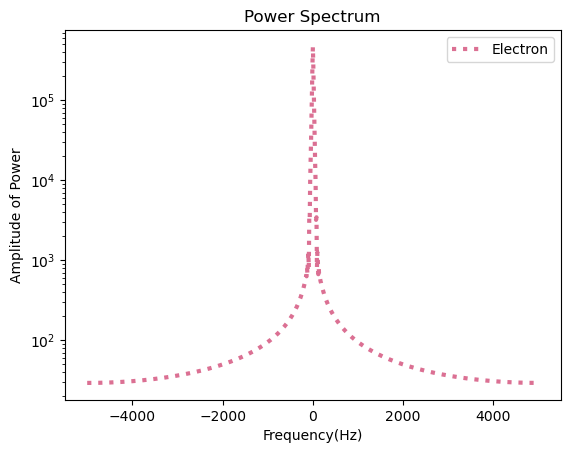

In [3154]:
# To cite Roman's Code: Gerasimov, Roman, production.ipynb, , https://colab.research.google.com/drive/1v5rQPIA24jJ82AmUrsd3sqg3WyF1WdZD?usp=sharing
## , Accesssed 4 Nov 2022)

transformed = fft.fftshift(fft.fft(mag_a)) #We use fft.fft to order the frequency component correctly. So the function should not double back on itself
amplitude = (2 / N) * np.abs(transformed) # We use take the absolute value and multipy by 2 over the number of iterations to normalize

freq = fft.fftshift(np.fft.fftfreq(N, dt)) 

# plt.plot(freq,amplitude)
# plt.yscale('log')
plt.plot(freq, amplitude, ls=":",linewidth=3, c= 'palevioletred', label = 'Electron')
plt.xlabel('Frequency(Hz)')
plt.ylabel('Amplitude of Power')
plt.title('Power Spectrum')
plt.yscale('log')
plt.legend()


# Now repeat all the steps that we did before

## 2 Initial Conditions Plot (x=-600, b=300, vx0= 10^5)

In [3123]:
# -- Empty Arrays --
rx2 = np.zeros([N])
vx2 = np.zeros([N])
ax2 = np.zeros([N])

ry2 = np.zeros([N])
vy2 = np.zeros([N])
ay2 = np.zeros([N])

#Time Array
T = np.zeros([N])



#-- Defining Constants -- 

k = 1 #/ (4 * np.pi * const.eps0) # Coulomb Constant
Z = 50 # Z is the charged ion since there is no specifications we can just use Z = 1
#q and me from: Brooks, A , Physical constants, https://www.physics.rutgers.edu/~abrooks/342/constants.html
# , Accessed Nov 2, 2022)
#q = const.e.esu.value
q = 4.8032*10**(-10)
me =  9.1094*10**(-28)
a0 = 5.2917721067 * 10**(-9)



#-- Initial Conditions -- 

#X-Component of the electron
rx20 = -600 #Initial Radius away from ion
rx2[0] = rx20 #This will be the first indice 
vx20 = 10**(5)#* u.cm/u.s # 10^7 cm/s but change to m/s because all the other constants are in m
vx2[0] = vx20

# #Y-Component of the electron
ry20 = 300 #Initial Radius away from ion
ry2[0] = ry20 # This will be the first indice 
vy20 = 0 # 10^7 cm/s but change to m/s because all the other constants are in m
vy2[0] = vy20

#Intial Time
T[0] = 0



#-- Create Loop for acceleration, time, and velocity --

for i in range(N):
    #X-components of the acceleration
    
    ax2[i] = coulomb_x(rx2[i], ry2[i], q)/ me
    ay2[i] = coulomb_y(rx2[i], ry2[i], q)/ me
    
#     ax[i]
#     ay[i]
    #print(axy)
    if i == N-1:
        break
    vx2[i+1] = vx2[i] + ax2[i] * dt
    vy2[i+1] = vy2[i] + ay2[i] * dt
    
    rx2[i+1] = rx2[i] + vx2[i] * dt + ((1.0 / 2.0) * ax2[i] * dt ** 2.0)
    ry2[i+1] = ry2[i] + vy2[i] * dt + ((1.0 / 2.0) * ay2[i] * dt ** 2.0)
    
    T[i+1] = T[i] + dt
    

#Create new magnitude array to find the correct fft for this specific simulation
mag_a2 = np.sqrt(ax2**2+ay2**2)
transformed2 = fft.fftshift(fft.fft(mag_a2)) #We use fft.fft to order the frequency component correctly. So the function should not double back on itself
amplitude2 = (2 / N) * np.abs(transformed2) # We use take the absolute value and multipy by 2 over the number of iterations to normalize

freq2 = fft.fftshift(np.fft.fftfreq(N, dt)) 
    

## 2 Plotting: Initial Conditions Plot (x=-600, b=300, vx0= 10^5)

#### I will be plotting in a subplots for the repetative steps, so the notebook does not get very long

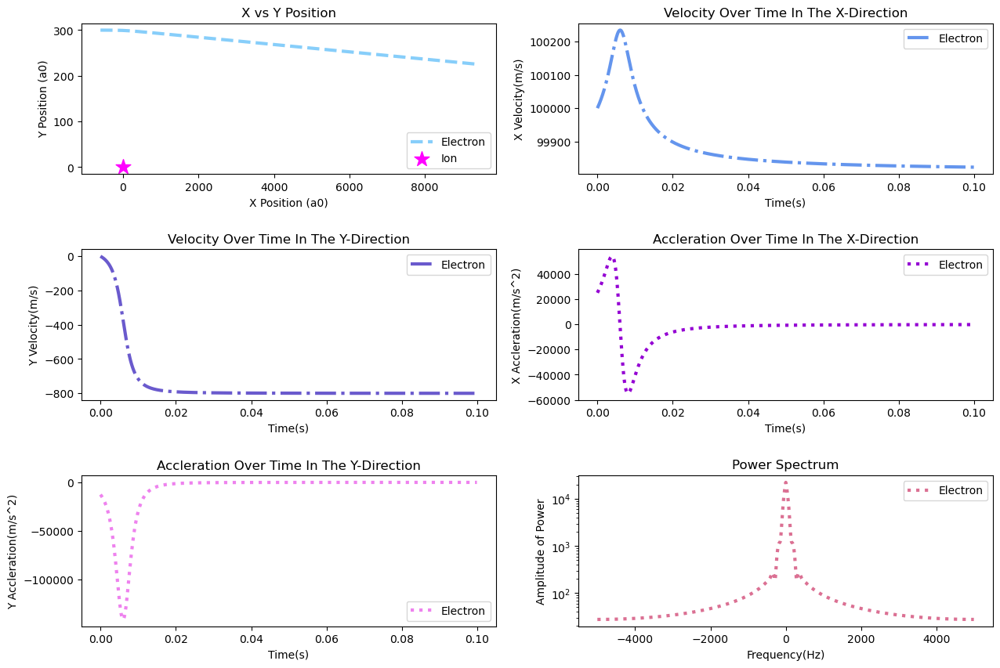

In [3155]:
# -- Set up subplots -- 
fig = plt.figure(figsize=(15, 10))
gs = fig.add_gridspec(3,2, hspace=0.5)
axs = gs.subplots(sharex=False, sharey=False)



# --Plot in the Grids --
axs[0, 0].plot(rx2, ry2, ls="--",linewidth=3, c= 'lightskyblue', label='Electron')
axs[0, 0].set_xlabel('X Position (a0)')
axs[0, 0].set_ylabel('Y Position (a0)')
axs[0, 0].set_title('X vs Y Position')
axs[0, 0].scatter(0, 0, c='magenta', marker='*', s = 200, label='Ion')
axs[0, 0].legend()

axs[0, 1].plot(T, vx2, ls="-.",linewidth=3, c= 'cornflowerblue',label = 'Electron')
axs[0, 1].set_xlabel('Time(s)')
axs[0, 1].set_ylabel('X Velocity(m/s)')
axs[0, 1].set_title('Velocity Over Time In The X-Direction')
axs[0, 1].legend()

axs[1, 0].plot(T, vy2, ls="-.",linewidth=3, c= 'slateblue',label = 'Electron')
axs[1, 0].set_xlabel('Time(s)')
axs[1, 0].set_ylabel('Y Velocity(m/s)')
axs[1, 0].set_title('Velocity Over Time In The Y-Direction')
axs[1, 0].legend()


axs[1, 1].plot(T, ax2, ls=":",linewidth=3, c= 'darkviolet',label = 'Electron')
axs[1, 1].set_xlabel('Time(s)')
axs[1, 1].set_ylabel('X Accleration(m/s^2)')
axs[1, 1].set_title('Accleration Over Time In The X-Direction')
axs[1, 1].legend()

axs[2, 0].plot(T, ay2, ls=":",linewidth=3, c= 'violet',label = 'Electron')
axs[2, 0].set_xlabel('Time(s)')
axs[2, 0].set_ylabel('Y Accleration(m/s^2)')
axs[2, 0].set_title('Accleration Over Time In The Y-Direction')
axs[2, 0].legend()


axs[2, 1].plot(freq2, amplitude2, ls=":",linewidth=3, c= 'palevioletred', label = 'Electron')
axs[2, 1].set_xlabel('Frequency(Hz)')
axs[2, 1].set_ylabel('Amplitude of Power')
axs[2, 1].set_title('Power Spectrum')
axs[2, 1].set_yscale('log')
axs[2, 1].legend()



### Above is an example of a larger impact parameter (initial y position) and a higher speed. The electron is barely deflected by the Ion because the electron is going at a higher speed and it is further away

### The power spectrum starts peaking at a shorter frequency when we make the impact parameter larger and have a higher speed. This power spectrum is much wider at the top and starts to tail off faster. The amplifude of the power spectrum also decreases with the parameters.

## 3 Initial Conditions Plot (x=-600, b=100, vx0=10^4)

In [3121]:
# -- Empty Arrays --
rx3 = np.zeros([N])
vx3 = np.zeros([N])
ax3 = np.zeros([N])

ry3 = np.zeros([N])
vy3 = np.zeros([N])
ay3 = np.zeros([N])

#Time Array
T = np.zeros([N])

#-- Initial Conditions -- 

#X-Component of the electron
rx30 = -600 #Initial Radius away from ion
rx3[0] = rx30 #This will be the first indice 
vx30 = 10**(4)#* u.cm/u.s # 10^7 cm/s but change to m/s because all the other constants are in m
vx3[0] = vx30

# #Y-Component of the electron
ry30 = 100 #Initial Radius away from ion
ry3[0] = ry30 # This will be the first indice 
vy30 = 0 # 10^7 cm/s but change to m/s because all the other constants are in m
vy3[0] = vy30

#Intial Time
T[0] = 0



#-- Create Loop for acceleration, time, and velocity --

for i in range(N):
    #X-components of the acceleration
    
    ax3[i] = coulomb_x(rx3[i], ry3[i], q)/ me
    ay3[i] = coulomb_y(rx3[i], ry3[i], q)/ me
    
#     ax[i]
#     ay[i]
    #print(axy)
    if i == N-1:
        break
    vx3[i+1] = vx3[i] + ax3[i] * dt
    vy3[i+1] = vy3[i] + ay3[i] * dt
    
    rx3[i+1] = rx3[i] + vx3[i] * dt + ((1.0 / 2.0) * ax3[i] * dt ** 2.0)
    ry3[i+1] = ry3[i] + vy3[i] * dt + ((1.0 / 2.0) * ay3[i] * dt ** 2.0)
    
    T[i+1] = T[i] + dt
    
    
#Create new magnitude array to find the correct fft for this specific simulation
mag_a3 = np.sqrt(ax3**2+ay3**2)
transformed3 = fft.fftshift(fft.fft(mag_a3)) #We use fft.fft to order the frequency component correctly. So the function should not double back on itself
amplitude3 = (2 / N) * np.abs(transformed3) # We use take the absolute value and multipy by 2 over the number of iterations to normalize

freq3 = fft.fftshift(np.fft.fftfreq(N, dt)) 
    

## 3 Plotting: Initial Conditions Plot (x=-600, b=100, vx0= 10^4)

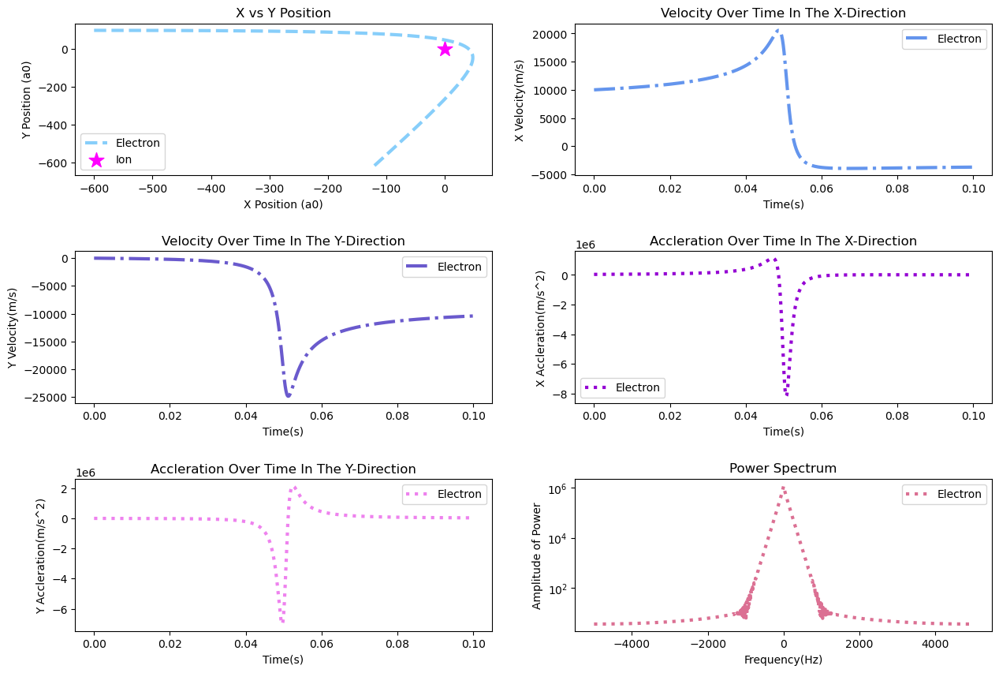

In [3156]:
# -- Set up subplots -- 
fig = plt.figure(figsize=(15, 10))
gs = fig.add_gridspec(3,2, hspace=0.5)
axs = gs.subplots(sharex=False, sharey=False)



# --Plot in the Grids --
axs[0, 0].plot(rx3, ry3, ls="--",linewidth=3, c= 'lightskyblue', label='Electron')
axs[0, 0].set_xlabel('X Position (a0)')
axs[0, 0].set_ylabel('Y Position (a0)')
axs[0, 0].set_title('X vs Y Position')
axs[0, 0].scatter(0, 0, c='magenta', marker='*', s = 200, label='Ion')
axs[0, 0].legend()

axs[0, 1].plot(T, vx3, ls="-.",linewidth=3, c= 'cornflowerblue',label = 'Electron')
axs[0, 1].set_xlabel('Time(s)')
axs[0, 1].set_ylabel('X Velocity(m/s)')
axs[0, 1].set_title('Velocity Over Time In The X-Direction')
axs[0, 1].legend()

axs[1, 0].plot(T, vy3, ls="-.",linewidth=3, c= 'slateblue',label = 'Electron')
axs[1, 0].set_xlabel('Time(s)')
axs[1, 0].set_ylabel('Y Velocity(m/s)')
axs[1, 0].set_title('Velocity Over Time In The Y-Direction')
axs[1, 0].legend()


axs[1, 1].plot(T, ax3, ls=":",linewidth=3, c= 'darkviolet',label = 'Electron')
axs[1, 1].set_xlabel('Time(s)')
axs[1, 1].set_ylabel('X Accleration(m/s^2)')
axs[1, 1].set_title('Accleration Over Time In The X-Direction')
axs[1, 1].legend()

axs[2, 0].plot(T, ay3, ls=":",linewidth=3, c= 'violet',label = 'Electron')
axs[2, 0].set_xlabel('Time(s)')
axs[2, 0].set_ylabel('Y Accleration(m/s^2)')
axs[2, 0].set_title('Accleration Over Time In The Y-Direction')
axs[2, 0].legend()


axs[2, 1].plot(freq3, amplitude3, ls=":",linewidth=3, c= 'palevioletred', label = 'Electron')
axs[2, 1].set_xlabel('Frequency(Hz)')
axs[2, 1].set_ylabel('Amplitude of Power')
axs[2, 1].set_title('Power Spectrum')
axs[2, 1].set_yscale('log')
axs[2, 1].legend()



### Above is an example of the electron going at a decent speed and the b being close to the Ion. Becuase the electron is going has a small b parameter it gets caught by the pull of the Ion and very heavily deflected.

### The power spectrum starts peaking at a longer frequency when we make the impact parameter smaller and have a normal speed. This means that there are more "higher ordered" sinusoidal waves filling the power spectrum that causes it to get wider. Compared to the last one this shape seems to be caused by the amount of deflection of the electron (this is correlated to the b and v parameters). The amplitude als goes back up higher than it was in run 1.

## 4 Initial Conditions Plot (x=-600, b=50, vx0=10^4)

In [3120]:
# -- Empty Arrays --
rx4 = np.zeros([N])
vx4 = np.zeros([N])
ax4 = np.zeros([N])

ry4 = np.zeros([N])
vy4 = np.zeros([N])
ay4 = np.zeros([N])

#Time Array
T = np.zeros([N])

#-- Initial Conditions -- 

#X-Component of the electron
rx40 = -600 #Initial Radius away from ion
rx4[0] = rx40 #This will be the first indice 
vx40 = 10**(4)#* u.cm/u.s # 10^7 cm/s but change to m/s because all the other constants are in m
vx4[0] = vx40

# #Y-Component of the electron
ry40 = 50 #Initial Radius away from ion
ry4[0] = ry40 # This will be the first indice 
vy40 = 0 # 10^7 cm/s but change to m/s because all the other constants are in m
vy4[0] = vy40

#Intial Time
T[0] = 0



#-- Create Loop for acceleration, time, and velocity --

for i in range(N):
    #X-components of the acceleration
    
    ax4[i] = coulomb_x(rx4[i], ry4[i], q)/ me
    ay4[i] = coulomb_y(rx4[i], ry4[i], q)/ me
    
#     ax[i]
#     ay[i]
    #print(axy)
    if i == N-1:
        break
    vx4[i+1] = vx4[i] + ax4[i] * dt
    vy4[i+1] = vy4[i] + ay4[i] * dt
    
    rx4[i+1] = rx4[i] + vx4[i] * dt + ((1.0 / 2.0) * ax4[i] * dt ** 2.0)
    ry4[i+1] = ry4[i] + vy4[i] * dt + ((1.0 / 2.0) * ay4[i] * dt ** 2.0)
    
    T[i+1] = T[i] + dt
    
#Create new magnitude array to find the correct fft for this specific simulation
mag_a4 = np.sqrt(ax4**2+ay4**2)
transformed4 = fft.fftshift(fft.fft(mag_a4)) #We use fft.fft to order the frequency component correctly. So the function should not double back on itself
amplitude4 = (2 / N) * np.abs(transformed4) # We use take the absolute value and multipy by 2 over the number of iterations to normalize

freq4 = fft.fftshift(np.fft.fftfreq(N, dt)) 
  

## 4 Plotting: Initial Conditions Plot  (x=-600, b=50, vx0=10^4)

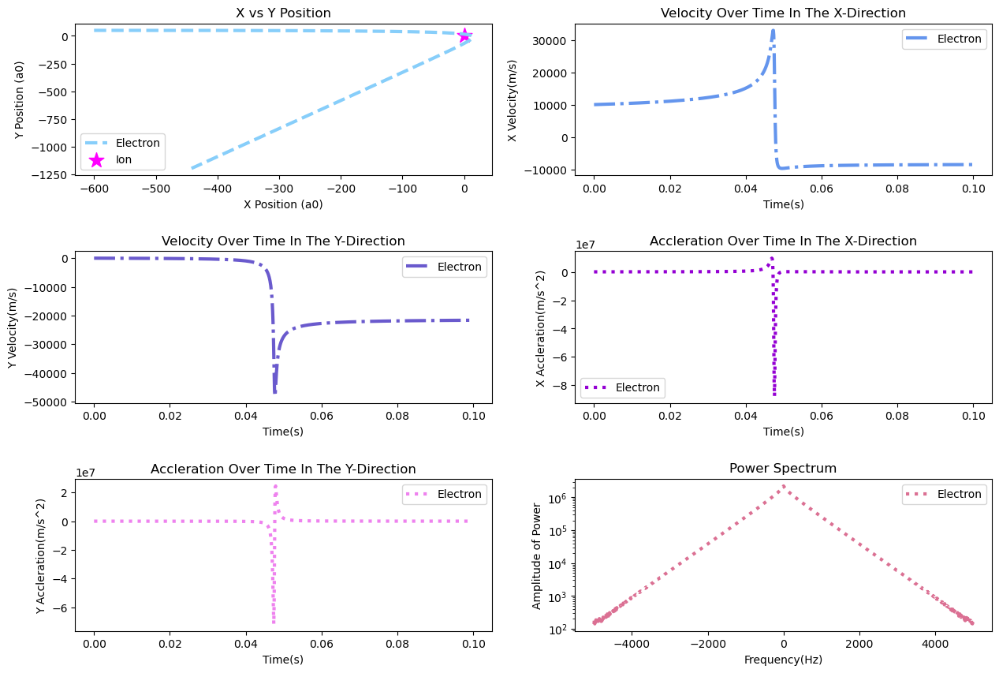

In [3157]:
# -- Set up subplots -- 
fig = plt.figure(figsize=(15, 10))
gs = fig.add_gridspec(3,2, hspace=0.5)
axs = gs.subplots(sharex=False, sharey=False)



# --Plot in the Grids --
axs[0, 0].plot(rx4, ry4, ls="--",linewidth=3, c= 'lightskyblue', label='Electron')
axs[0, 0].set_xlabel('X Position (a0)')
axs[0, 0].set_ylabel('Y Position (a0)')
axs[0, 0].set_title('X vs Y Position')
axs[0, 0].scatter(0, 0, c='magenta', marker='*', s = 200, label='Ion')
axs[0, 0].legend()

axs[0, 1].plot(T, vx4, ls="-.",linewidth=3, c= 'cornflowerblue',label = 'Electron')
axs[0, 1].set_xlabel('Time(s)')
axs[0, 1].set_ylabel('X Velocity(m/s)')
axs[0, 1].set_title('Velocity Over Time In The X-Direction')
axs[0, 1].legend()

axs[1, 0].plot(T, vy4, ls="-.",linewidth=3, c= 'slateblue',label = 'Electron')
axs[1, 0].set_xlabel('Time(s)')
axs[1, 0].set_ylabel('Y Velocity(m/s)')
axs[1, 0].set_title('Velocity Over Time In The Y-Direction')
axs[1, 0].legend()


axs[1, 1].plot(T, ax4, ls=":",linewidth=3, c= 'darkviolet',label = 'Electron')
axs[1, 1].set_xlabel('Time(s)')
axs[1, 1].set_ylabel('X Accleration(m/s^2)')
axs[1, 1].set_title('Accleration Over Time In The X-Direction')
axs[1, 1].legend()

axs[2, 0].plot(T, ay4, ls=":",linewidth=3, c= 'violet',label = 'Electron')
axs[2, 0].set_xlabel('Time(s)')
axs[2, 0].set_ylabel('Y Accleration(m/s^2)')
axs[2, 0].set_title('Accleration Over Time In The Y-Direction')
axs[2, 0].legend()


axs[2, 1].plot(freq4, amplitude4, ls=":",linewidth=3, c= 'palevioletred', label = 'Electron')
axs[2, 1].set_xlabel('Frequency(Hz)')
axs[2, 1].set_ylabel('Amplitude of Power')
axs[2, 1].set_title('Power Spectrum')
axs[2, 1].set_yscale('log')
axs[2, 1].legend()


### Above is an example of the electron starting from very close in the y direction (small b) and going at the same speed as run 3. You can see that  impact parameter greatly affects how much the electron will be deflected around the Ion. In this case it is heavily influenced by the Ion.

### The power spectrum starts peaking at a much longer frequency when we make the impact parameter way smaller and have a normal speed. Compared to the last one this shape defintly seems to depend on how deflected the electron is from the ion. The amplitude is also around the same as the last run.

## 5 Initial Conditions Plot (x=-600, b=50, vx0=10^7)

In [3126]:
# -- Empty Arrays --
rx5 = np.zeros([N])
vx5 = np.zeros([N])
ax5 = np.zeros([N])

ry5 = np.zeros([N])
vy5 = np.zeros([N])
ay5 = np.zeros([N])

#Time Array
T = np.zeros([N])

#-- Initial Conditions -- 

#X-Component of the electron
rx50 = -600 #Initial Radius away from ion
rx5[0] = rx50 #This will be the first indice 
vx50 = 10**(7)#* u.cm/u.s # 10^7 cm/s but change to m/s because all the other constants are in m
vx5[0] = vx50

# #Y-Component of the electron
ry50 = 50 #Initial Radius away from ion
ry5[0] = ry50 # This will be the first indice 
vy50 = 0 # 10^7 cm/s but change to m/s because all the other constants are in m
vy5[0] = vy50

#Intial Time
T[0] = 0



#-- Create Loop for acceleration, time, and velocity --

for i in range(N):
    #X-components of the acceleration
    
    ax5[i] = coulomb_x(rx5[i], ry5[i], q)/ me
    ay5[i] = coulomb_y(rx5[i], ry5[i], q)/ me
    
#     ax[i]
#     ay[i]
    #print(axy)
    if i == N-1:
        break
    vx5[i+1] = vx5[i] + ax5[i] * dt
    vy5[i+1] = vy5[i] + ay5[i] * dt
    
    rx5[i+1] = rx5[i] + vx5[i] * dt + ((1.0 / 2.0) * ax5[i] * dt ** 2.0)
    ry5[i+1] = ry5[i] + vy5[i] * dt + ((1.0 / 2.0) * ay5[i] * dt ** 2.0)
    
    T[i+1] = T[i] + dt
    
#Create new magnitude array to find the correct fft for this specific simulation
mag_a5 = np.sqrt(ax5**2+ay5**2)
transformed5 = fft.fftshift(fft.fft(mag_a5)) #We use fft.fft to order the frequency component correctly. So the function should not double back on itself
amplitude5 = (2 / N) * np.abs(transformed5) # We use take the absolute value and multipy by 2 over the number of iterations to normalize

freq5 = fft.fftshift(np.fft.fftfreq(N, dt))
  

## 5 Plotting: Initial Conditions Plot  (x=-600, b=50, vx0=10^7)

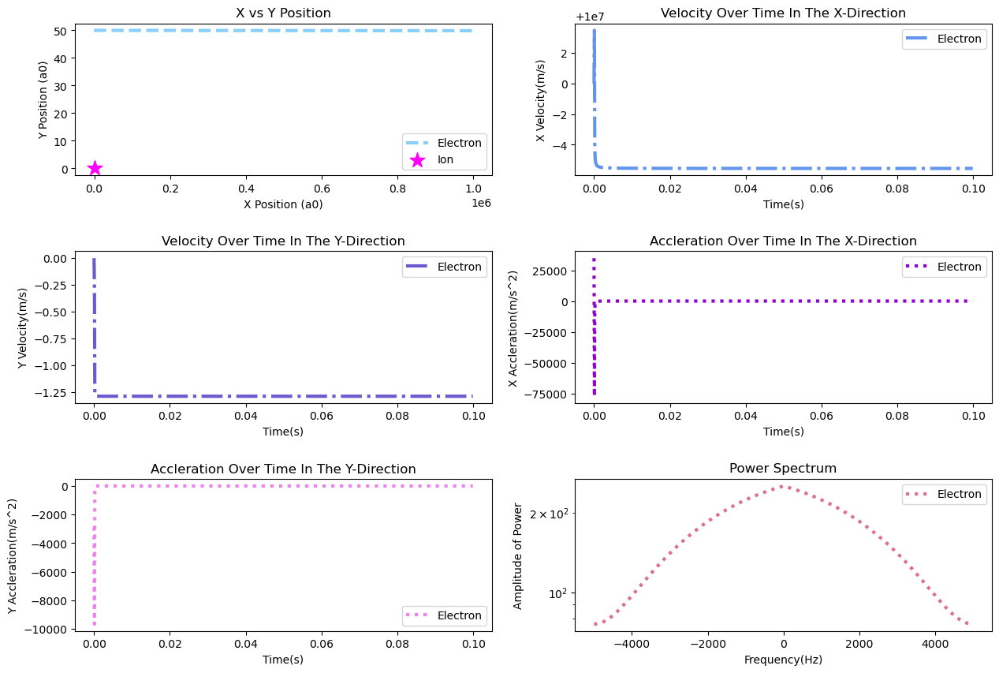

In [3158]:
# -- Set up subplots -- 
fig = plt.figure(figsize=(15, 10))
gs = fig.add_gridspec(3,2, hspace=0.5)
axs = gs.subplots(sharex=False, sharey=False)



# --Plot in the Grids --
axs[0, 0].plot(rx5, ry5, ls="--",linewidth=3, c= 'lightskyblue', label='Electron')
axs[0, 0].set_xlabel('X Position (a0)')
axs[0, 0].set_ylabel('Y Position (a0)')
axs[0, 0].set_title('X vs Y Position')
axs[0, 0].scatter(0, 0, c='magenta', marker='*', s = 200, label='Ion')
axs[0, 0].legend()

axs[0, 1].plot(T, vx5, ls="-.",linewidth=3, c= 'cornflowerblue',label = 'Electron')
axs[0, 1].set_xlabel('Time(s)')
axs[0, 1].set_ylabel('X Velocity(m/s)')
axs[0, 1].set_title('Velocity Over Time In The X-Direction')
axs[0, 1].legend()

axs[1, 0].plot(T, vy5, ls="-.",linewidth=3, c= 'slateblue',label = 'Electron')
axs[1, 0].set_xlabel('Time(s)')
axs[1, 0].set_ylabel('Y Velocity(m/s)')
axs[1, 0].set_title('Velocity Over Time In The Y-Direction')
axs[1, 0].legend()


axs[1, 1].plot(T, ax5, ls=":",linewidth=3, c= 'darkviolet',label = 'Electron')
axs[1, 1].set_xlabel('Time(s)')
axs[1, 1].set_ylabel('X Accleration(m/s^2)')
axs[1, 1].set_title('Accleration Over Time In The X-Direction')
axs[1, 1].legend()

axs[2, 0].plot(T, ay5, ls=":",linewidth=3, c= 'violet',label = 'Electron')
axs[2, 0].set_xlabel('Time(s)')
axs[2, 0].set_ylabel('Y Accleration(m/s^2)')
axs[2, 0].set_title('Accleration Over Time In The Y-Direction')
axs[2, 0].legend()


axs[2, 1].plot(freq5, amplitude5, ls=":",linewidth=3, c= 'palevioletred', label = 'Electron')
axs[2, 1].set_xlabel('Frequency(Hz)')
axs[2, 1].set_ylabel('Amplitude of Power')
axs[2, 1].set_title('Power Spectrum')
axs[2, 1].set_yscale('log')
axs[2, 1].legend()


### This is the case with a still a small b like in case 4, but now we have a very fast initial velocity. Now we can see that even with a low b parameter, if the electron is moving very fast it does not care about the ion and is not deflected at all.